# Physics 641 - Ising Model Project

## Tucker Knaak - Department of Physics, Creighton University - Spring 2024

### Problem 5.14. Simulation of the two-dimensional Ising model.

#### Use Program $\textit{Ising2d}$ to explore some of the properties of the two-dimensional Ising model on a square lattice at a given temperature $T$ and external magnetic field $H$.  First choose $N=L^2=32^2$ and set $H=0$.  The initial orientation of the spins is all spins up.

#### (a) Choose $T=10$ and run until equilibrium has been established.  Is the orientation of the spins random and the mean magnetization approximately equal to zero?  What is a typical size of a domain (a region of parallel spins)?

#### (b) Choose a low temperature such as $T=0.75$.  Are the spins still random or is there a preferred direction?  You will notice that $\langle M\rangle\approx0$ for sufficiently high $T$ and $\langle M\rangle\neq0$ for suffiently low $T$.  Hence, there is an intermediate value of $T$ at which $\langle M\rangle$ first becomes nonzero.

#### (c) Choose $L=4$ and $T=2$.  Does the sign of $M$ change during the simulation?  Choose a larger value of $L$ and observe if the sign of $M$ changes.  Will the sign of $M$ change for $L\gg1$?  Should a theoretical calculation of $\langle M\rangle$ yield $\langle M\rangle\neq0$ or $\langle M\rangle=0$ for $T<T_c$?

#### (d) Set $L=32$.  Start at $T=4$ and determine the temperature dependence of $m$, the zero-field susceptibility $\chi$, the mean energy per spin $E/N$, and the specific heat $C$.  Decrease the temperature in intervals of $0.2$ until $T\approx1.6$, equilibrating for at least $1000$ mcs before collecting data at each value of $T$.  Describe the qualitative temperature dependence of these quantities.  (When the simulation is stopped, the mean magnetization and the mean of the absolute value of the magnetization is returned.)  Because $M$ sometimes changes sign for small systems, the value of $\langle\vert m\vert\rangle$ is a more accurate representation of the magnetization.  For this reason the susceptibility is given by $\chi=\left[\langle M^2\rangle-\langle\vert M\vert\rangle^2\right]/kT$, rather than by (5.28).

#### (e) Set $T=T_c\approx2.269$ and choose $L\geq128$.  Obtain $\langle m\rangle$ for $H=0.01,\ 0.02,\ 0.04,\ 0.08,\text{ and }0.16$.  Make sure you equilibrate the system at each value of $H$ before collecting data.  Make a log-log plot of $m$ versus $H$ and estimate the critical exponent $\delta$ using (5.88).  A method for estimating the critical exponents $\alpha,\ \beta,\text{ and }\gamma$ is discussed in Problem 5.38.

### Extension Problem.  "Box" Boundary Conditions.

#### A typical two-dimensional Ising model on a square lattice uses Toroidal Boundary Conditions and has a given spin interact with the spin above, below, left, and right.  We propose a new Box Boundary Condition where a given spin also interacts on the diagonal with the spin above to the left, above to the right, below to the left, and below to the right.  We use Problem 5.14 as a guideline to examine the cases and phases of the two-dimensional Ising model with the new boundary conditions.

In [1]:
'''Required Libraries'''
import matplotlib.animation as animation
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
import numpy as np
import matplotlib

'''Required Functions'''
from scipy.odr import ODR, Model, Data, RealData
from IPython.display import HTML, display
from scipy.special import ellipk, ellipe
from matplotlib.colors import Normalize

'''Adjust Animation Size'''
matplotlib.rcParams['animation.embed_limit'] = 2**128

#### The following cell defines the Ising2D class used to investigate a two-dimensional Ising model on a square lattice as described above in Problem 5.14.  The user can create an instance of the class by calling Ising2D() and can specify the lattice size, the external magnetic field, the temperature of the system, and the boundary conditions for interactions.  The user can then simulate the Metropolis algorithm to find the equilibrium state by calling Metropolis() and can specify the number of steps conducted.  Next, the user can make a table of the relevant thermodynamic variables describing the system as well as plots of the average energy per particle and average magnetization per particle by calling plot_em().  Furthermore, the user can plot the orientation of the spins on the lattice at equilibrium by calling plot_spins().  Lastly, the user can animate the flipping of the spins during the Metropolis algorithm by calling animate_spins().

In [23]:
class Ising2D():
    
    '''Internal function to initialize the necessary variables of the class'''
    def __init__(self, lattice_size: int, H: float, T: float, BC: str):
        
        '''Lattice'''
        self.L = lattice_size  #length and width of lattice
        self.N = self.L**2     #total number of spins
        self.BC = BC.title()   #boundary conditions
        
        '''Spins'''
        self.spins = np.ones((self.L, self.L), dtype = float)  #all spins are up initially
        self.spins_list = []                                   #list of spin orientations on lattice each step in algorithm
        
        '''Constants'''
        self.u = 1   #magnetic moment [A * m^2]
        self.J = 1   #interaction energy [J]
        self.H = H   #external magnetic field [N / A * m]
        self.T = T   #temperature of system [K]
        self.kB = 1  #Boltzmann's constant [J / K]
        
        '''Thermodynamic Variables'''
        self.e = 0        #mean energy per particle at equilibrium [J]
        self.m = 0        #mean magnetization per particle at equilibrium [A / m]
        self.C = 0        #heat capacity at equilibrium [J / K]
        self.X = 0        #zero-field susceptibility
        self.e_list = []  #list of mean energy per particle at each step of algorithm
        self.m_list = []  #list of mean magnetization per particle at each step of algorithm
        
        '''Algorithm'''
        self.E = 0              #total energy of the system [J]
        self.M = 0              #total magnetization of the system [A / m]
        self.E_list = []        #list of total energy at each step of algorithm
        self.M_list = []        #list of total magnetization at each step of algorithm
        self.save_spins = None  #boolean to determine to save configuration of spins each step or not
        self.num_steps = 0      #number of steps for the algorithm
        self.steps_list = []    #list of the number of steps
        
        
    '''Internal function to append the relevant data of the system during the Metropolis algorithm'''
    def _append(self):
        self.E_list.append(self.E)
        self.M_list.append(self.M)
        if self.save_spins:
            self.spins_list.append(np.copy(self.spins))
        
        
    '''Internal function to calculate the thermodynamic variables describing the system at equilibrium'''
    def _thermodynamic_variables(self):
        
        '''Consider energy and magnetization after system reaches equilibrium'''
        equilibrium = 4 * self.num_steps // 5  #we ensure self.num_steps >> steps required to reach equilibrium
        
        '''Mean energy per particle'''
        E_mean = np.mean(self.E_list[equilibrium:])          #mean energy at equilibrium
        E_var = np.var(self.E_list[equilibrium:], ddof = 1)  #variance of energy at equilibrium
        self.e = E_mean / self.N                             #e = E / N
        self.e_list = [E / self.N for E in self.E_list]      #list of mean energy per particle
        
        '''Mean magnetization per particle'''
        M_mean = np.mean(self.M_list[equilibrium:])                     #mean magnetization at equilibrium
        Mabs_var = np.var(np.abs(self.M_list[equilibrium:]), ddof = 1)  #variance of abs(magnetization) at equilibrium
        self.m = M_mean / self.N                                        #m = M / N
        self.m_list = [M / self.N for M in self.M_list]                 #list of mean magnetization per particle
        
        '''Heat capacity per particle'''
        self.C = E_var / (self.kB * self.T**2 * self.N)  #C = (< E^2 > - < E >^2) / (kB * T^2 * N)
        
        '''Zero-field susceptibility per particle'''
        self.X = Mabs_var / (self.kB * self.T * self.N)  #X = (< M^2 > - < |M| >^2) / (kB * T * N)
        
        
    '''Internal function to conduct one step in the Metropolis algorithm with Toroidal Boundary Conditions'''
    def _step_toroidal(self):
        
        '''Choose random spin to flip'''
        i, j = np.random.randint(0, self.L, size = 2)
        
        '''Find the nearest neighbors for Toroidal Boundary Conditions'''
        l = self.spins[i, (j - 1) % self.L]  #spin to the left
        r = self.spins[i, (j + 1) % self.L]  #spin to the right
        a = self.spins[(i - 1) % self.L, j]  #spin above
        b = self.spins[(i + 1) % self.L, j]  #spin below
        
        '''Calculate change in energy due to flip'''
        dE = 2 * self.spins[i, j] * (self.J * (l + r + a + b) + self.u * self.H)
        
        '''Check conditions for flip'''
        if dE <= 0 or np.random.rand() < np.exp(-dE / (self.kB * self.T)):
            self.spins[i, j] *= -1          #flip spin
            self.E += dE                    #update energy
            self.M += 2 * self.spins[i, j]  #update magnetization
            
        '''Append relevant data'''
        self._append()
        
        
    '''Internal function to conduct one step in the Metropolis algorithm with Box Boundary Conditions'''
    def _step_box(self):
        
        '''Choose random spin to flip'''
        i, j = np.random.randint(0, self.L, size = 2)
        
        '''Find the nearest neighbors for Box Boundary Conditions'''
        l = self.spins[i, (j - 1) % self.L]                  #spin to the left
        r = self.spins[i, (j + 1) % self.L]                  #spin to the right
        a = self.spins[(i - 1) % self.L, j]                  #spin above
        b = self.spins[(i + 1) % self.L, j]                  #spin below 
        al = self.spins[(i - 1) % self.L, (j - 1) % self.L]  #spin above and to the left
        ar = self.spins[(i - 1) % self.L, (j + 1) % self.L]  #spin above and to the right
        bl = self.spins[(i + 1) % self.L, (j - 1) % self.L]  #spin below and to the left
        br = self.spins[(i + 1) % self.L, (j + 1) % self.L]  #spin below and to the right
        
        '''Calculate change in energy due to flip'''
        dE = 2 * self.spins[i, j] * (self.J * (l + r + a + b + al + ar + bl + br) + self.u * self.H)
        
        '''Check conditions for flip'''
        if dE <= 0 or np.random.rand() < np.exp(-dE / (self.kB * self.T)):
            self.spins[i, j] *= -1          #flip spin
            self.E += dE                    #update energy
            self.M += 2 * self.spins[i, j]  #update magnetization
            
        '''Append relevant data'''
        self._append()
        
        
    '''Function called by the user to conduct a Metropolis algorithm of flipping spins for a given number of steps'''
    def Metropolis(self, num_steps: int, save_spins = False):
        
        '''Set initial conditions'''
        self.num_steps = num_steps
        self.steps_list = [step for step in range(num_steps + 1)]
        self.save_spins = save_spins
        self.M = np.sum(self.spins)                                #M = SUM_ij(s_ij)
        self.E = -2 * self.J * self.N + self.u * self.H * self.N   #E = -2 * J * SUM_i,j(s_i * s_j) + u * H * SUM_ij(s_ij)
        self._append()
        
        '''Conduct Metropolis algorithm for given number of steps and given boundary conditions'''
        if self.BC == 'Toroidal':
            for step in range(self.num_steps):
                self._step_toroidal()
        elif self.BC == 'Box':
            for step in range(self.num_steps):
                self._step_box()
        else:
            raise ValueError('Wrong boundary conditions entered!  Please choose "Toroidal" or "Box"!')
            
        '''Calculate thermodynamic variables of system'''
        self._thermodynamic_variables()
        
        
    '''Function called by the user to plot the mean energy per particle and mean magnetization per particle
       during the Metropolis algorithm as well as a table of the thermodynamic variables calculated'''
    def plot_em(self, save_fig = False):
        
        '''Create figure'''
        fig = plt.figure(figsize = (16, 7))
        fig.tight_layout(pad = 3)
        gs = gridspec.GridSpec(2, 4, height_ratios=[6, 1])
        gs.update(hspace = 0.5)
        gs.update(wspace = 0.35)
        
        '''First figure --> E / N, m, C / N*kB, X / N table'''
        ax1 = plt.subplot(gs[1, 1:3])
        ax1.axis('off')
        ax1.set_title(f'Thermodynamic Variables of the System - {self.BC} BC')
        table = [[f'{self.num_steps:.0f}', f'{self.e:.4f} J', f'{self.m:.4f} A/m', f'{self.C:.4f}', f'{self.X:.4f}']]
        labels = ['Steps', 'E / N', 'm', 'C / N\u00B7kB', 'X / N\u00B7kB']
        the_table = ax1.table(cellText = table, colLabels = labels, loc = 'center', cellLoc = 'center')
        the_table.scale(1, 2)
        for (row, col), cell in the_table.get_celld().items():
            if (row == 0) or (col == -1):
                cell.set_text_props(fontweight = 'bold')
                
        '''Second figure --> E / N plot'''
        ax2 = plt.subplot(gs[0, :2])
        ax2.set_xlabel('Steps')
        ax2.set_ylabel('$E\ /\ N\,J$')
        ax2.set_title(f'Mean Energy Per Particle (L = {self.L}, H = {self.H}N/A\u00B7m, T = {self.T}K)')
        ax2.grid(True, linestyle = 'dashed', color = 'darkgray', alpha = 0.25)
        ax2.plot(self.steps_list[::100], self.e_list[::100], linestyle = 'solid', color = 'dodgerblue')
        
        '''Third figure --> m plot'''
        ax3 = plt.subplot(gs[0, 2:])
        ax3.set_xlabel('Steps')
        ax3.set_ylabel('$m$')
        ax3.set_title(f'Mean Magnetization Per Particle (L = {self.L}, H = {self.H}N/A\u00B7m, T = {self.T}K)')
        ax3.grid(True, linestyle = 'dashed', color = 'darkgray', alpha = 0.25)
        ax3.plot(self.steps_list[::100], self.m_list[::100], linestyle = 'solid', color = 'darkorange')
        
        '''Save figure'''
        if save_fig:
            fig.savefig('c:/Users/Tucker Knaak/Downloads/{N}Spins_H{H}_T{T}_em_{BC}.png'.format(
                         N = self.N, H = self.H, T = self.T, BC = self.BC), bbox_inches = 'tight')
            
            
    '''Function called by the user to plot the orientation of the spins on the lattice at equilibrium'''
    def plot_spins(self, save_fig = False):
        
        '''Create figure'''
        fig, ax = plt.subplots(1, 1, figsize = (8, 8))
        ax.set_aspect('equal', 'box')
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title(f'{self.L}x{self.L} Lattice of Spins at Equilibrium (H = {self.H}N/A\u00B7m, T = {self.T}K)')
        
        '''Plot spins'''
        im = ax.imshow(self.spins, cmap = 'binary_r', interpolation = 'nearest', norm = Normalize(vmin = -1, vmax = 1))
        cbar = fig.colorbar(im, ax = ax, shrink = 0.805, ticks = [-1, 1], boundaries = [-2, 0, 2])
        cbar.ax.set_yticklabels(['Down', 'Up'])
        cbar.ax.tick_params(left = False, right = False)
        
        '''Save figure'''
        if save_fig:
            fig.savefig('c:/Users/Tucker Knaak/Downloads/{N}Spins_H{H}_T{T}_spins_{BC}.png'.format(
                         N = self.N, H = self.H, T = self.T, BC = self.BC))
            
    
    '''Internal function to update the animation of the orientation of the spins on the lattice'''
    def _update_spins(self, step, fig, ax):
        
        '''Clear last figure'''
        ax.clear()
        
        '''New figure'''
        ax.set_aspect('equal', 'box')
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title(f'{self.L}x{self.L} Lattice of Spins (H = {self.H}N/A\u00B7m, T = {self.T}K, Step = {step})')
        
        '''New spins'''
        im = ax.imshow(self.spins_list[step], cmap = 'binary_r', interpolation = 'nearest',
                       norm = Normalize(vmin = -1, vmax = 1))
        
        '''Return Artist elements'''
        return fig, ax
    
    
    '''Function called by the user to animate the orientation of the spins on the lattice during the Metropolis algorithm'''
    def animate_spins(self, save_fig = False):
        
        '''Create figure'''
        fig, ax = plt.subplots(1, 1, figsize = (8, 8))
        ax.set_aspect('equal', 'box')
        ax.set_xticks([])
        ax.set_yticks([])
        
        '''Animation parameters'''
        num_frames = 100                                      #number of frames in animation
        step_size = self.num_steps // num_frames              #step size for the frames
        frames = np.arange(0, self.num_steps + 1, step_size)  #set frames to plot in animation
        frames[-1] = self.num_steps                           #set final frame to be the last step
        
        '''Create animation'''
        ani = animation.FuncAnimation(fig, self._update_spins, interval = 75, frames = frames,
                                      fargs = (fig, ax), repeat = False)
        html = HTML(ani.to_jshtml())
        display(html)
        plt.close()
        
        '''Save animation'''
        if save_fig:
            f = r'c:/Users/Tucker Knaak/Downloads/{N}Spins_H{H}_T{T}_spins_{BC}.gif'.format(N = self.N, H = self.H,
                                                                                            T = self.T, BC = self.BC)
            writergif = animation.PillowWriter(fps = 10)
            ani.save(f, writer = writergif)

### Problem 5.14. Simulation of the two-dimensional Ising model.

#### (a) Choose $T=10$ and run until equilibrium has been established.  Is the orientation of the spins random and the mean magnetization approximately equal to zero?  What is a typical size of a domain (a region of parallel spins)?

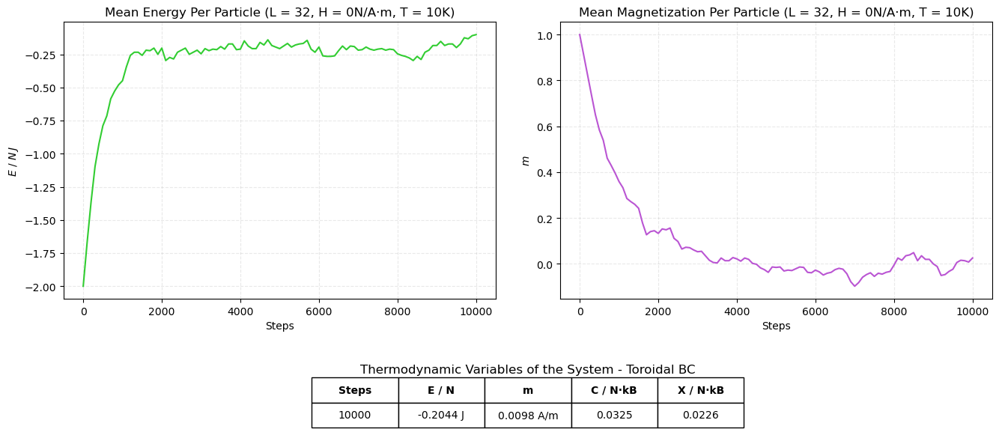

In [3]:
'''Set the system parameters'''
L = 32     #size of the lattice
H = 0      #external magnetic field [N / A * m]
T = 10     #temperature of the system [K]
n = 10000  #number of steps for the Metropolis algorithm

'''Create an instance of the class and conduct the Metropolis algorithm'''
a = Ising2D(L, H, T, 'Toroidal')
a.Metropolis(n, save_spins = True)

'''Plot the relevant thermodynamic variables'''
a.plot_em(save_fig = True)

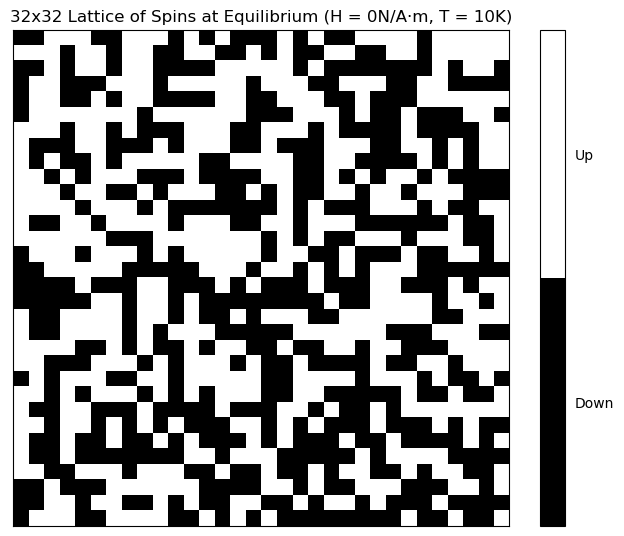

In [4]:
'''Plot orientation of the spins at equilibrium'''
a.plot_spins(save_fig = True)

In [5]:
'''Animate the orientation of the spins during the algorithm'''
a.animate_spins(save_fig = True)

##### Since the temperature of the system is higher than the critical temperature, $T=10\text{K}\gg T_c\approx2.269\text{K}$, we are in the paramagnetic phase.  This implies that the spins should be randomly oriented and that the mean magnetization is approximately equal to zero.  In this simulation with $n=10000$ steps, we found the average magnetization per particle to be $\langle m\rangle=0.0098\text{A/m}$ as expected.  Looking at the orientation of the spins at equilibrium, we do not see any domain walls.  Furthermore, we estimate that the average size of a domain is approximately $3\times3$.  This implies that if we are to pick a random $3\times3$ square in the lattice, we would expect the spins to be mostly all aligned in that region.

#### (b) Choose a low temperature such as $T=0.75$.  Are the spins still random or is there a preferred direction?  You will notice that $\langle M\rangle\approx0$ for sufficiently high $T$ and $\langle M\rangle\neq0$ for suffiently low $T$.  Hence, there is an intermediate value of $T$ at which $\langle M\rangle$ first becomes nonzero.

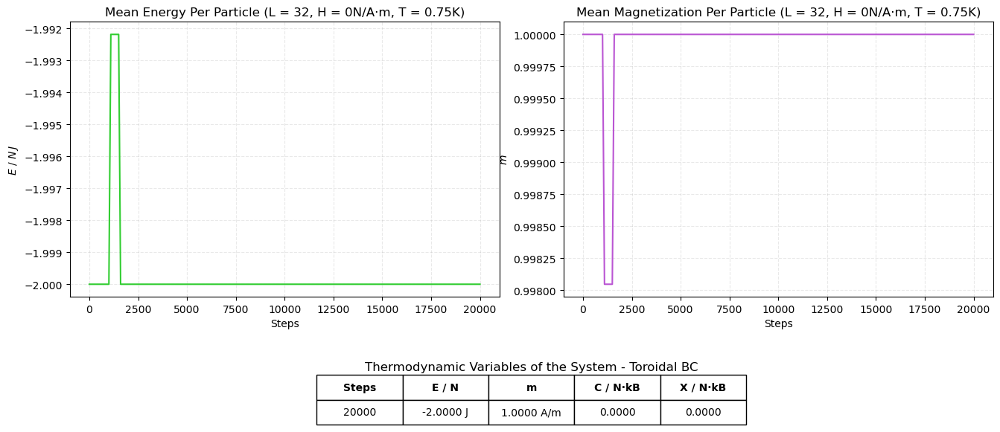

In [6]:
'''Set the system parameters'''
L = 32     #size of the lattice
H = 0      #external magnetic field [N / A * m]
T = 0.75   #temperature of the system [K]
n = 20000  #number of steps for the Metropolis algorithm

'''Create an instance of the class and conduct the Metropolis algorithm'''
b = Ising2D(L, H, T, 'Toroidal')
b.Metropolis(n, save_spins = True)

'''Plot the relevant thermodynamic variables'''
b.plot_em(save_fig = True)

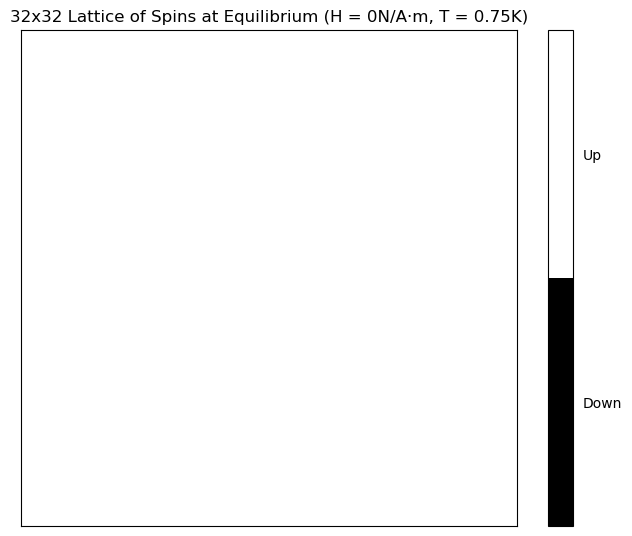

In [7]:
'''Plot orientation of the spins at equilibrium'''
b.plot_spins(save_fig = True)

In [8]:
'''Animate the orientation of the spins during the algorithm'''
b.animate_spins(save_fig = True)

##### Since the temperature of the system is lower than the critical temperature, $T=0.75\text{K}\ll T_c\approx2.269\text{K}$, we are in the ferromagnetic phase.  This implies that there should be a preferred direction and that the mean magnetization is nonzero.  In this simulation with $n=20000$ steps, we found the average magnetization per particle to be $\langle m\rangle=1.000$ as expected.  This shows that each spin on the lattice is oriented up and that there is a definite preferred direction.  Although there is a preferred direction, we found that the system is still subject to fluctuations.  We saw that one spin flipped near the beginning of the simulation but then flipped back to its original state shortly after this.

#### (c) Choose $L=4$ and $T=2$.  Does the sign of $M$ change during the simulation?  Choose a larger value of $L$ and observe if the sign of $M$ changes.  Will the sign of $M$ change for $L\gg1$?  Should a theoretical calculation of $\langle M\rangle$ yield $\langle M\rangle\neq0$ or $\langle M\rangle=0$ for $T<T_c$?

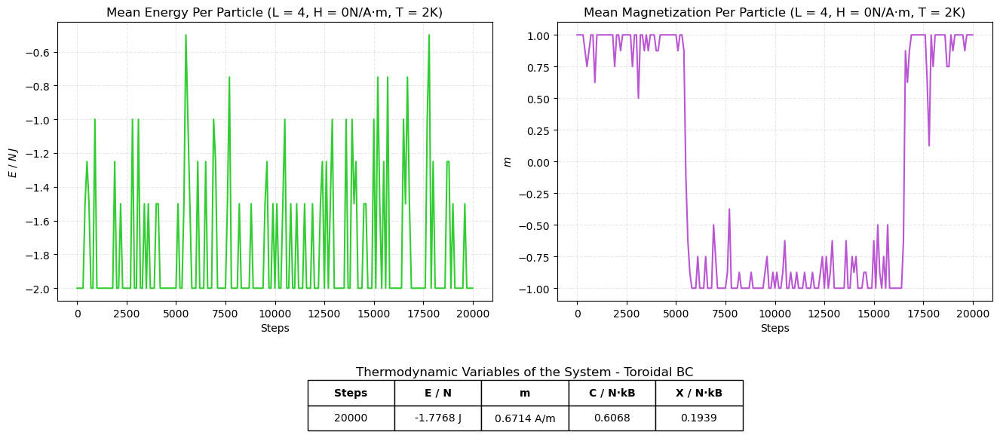

In [11]:
'''Set the system parameters'''
L1 = 4      #size of the lattice
H = 0       #external magnetic field [N / A * m]
T = 2       #temperature of the system [K]
n1 = 20000  #number of steps for the Metropolis algorithm

'''Create an instance of the class and conduct the Metropolis algorithm'''
c1 = Ising2D(L1, H, T, 'Toroidal')
c1.Metropolis(n1, save_spins = True)

'''Plot the relevant thermodynamic variables'''
c1.plot_em(save_fig = True)

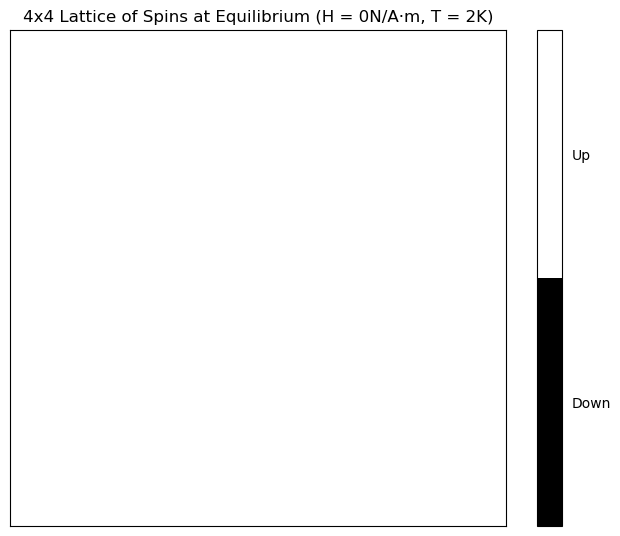

In [12]:
'''Plot orientation of the spins at equilibrium'''
c1.plot_spins(save_fig = True)

In [13]:
'''Animate the orientation of the spins during the algorithm'''
c1.animate_spins(save_fig = True)

##### For a small lattice, only a small number of flips are required to occur in order to flip the sign of the magnetization.  Since the temperature of the system is near the critical temperature, there will be large fluctuations.  Therefore, it is not surprising if the sign of the magnetization were to change.  For $L=4$ and $T=2\text{K}$, we found that the sign of the magnetization per particle changed twice during the simulation with $n=20000$.  The spins were initially all oriented up, but they had all flipped to spin down after approximately $6000$ steps.  The orientation of the spins then remained mostly down until approximately $16000$ steps, at which point the spins had all flipped back to spin up.  At equilibrium, we found the average magnetization per particle to be $\langle m\rangle=0.6714\text{A/m}$.  This implies there was a preferred direction but there were also large fluctuations.

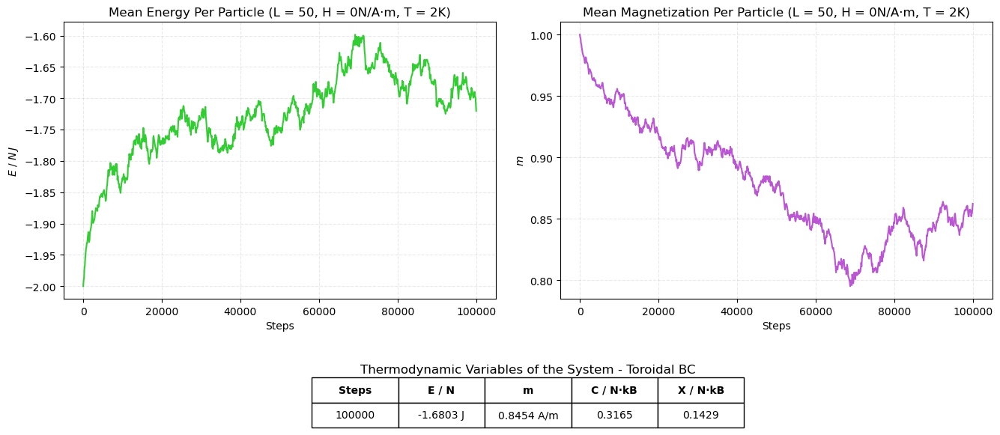

In [14]:
'''Set the system parameters'''
L2 = 50     #size of the lattice
H = 0       #external magnetic field [N / A * m]
T = 2       #temperature of the system [K]
n = 100000  #number of steps for the Metropolis algorithm

'''Create an instance of the class and conduct the Metropolis algorithm'''
c2 = Ising2D(L2, H, T, 'Toroidal')
c2.Metropolis(n, save_spins = True)

'''Plot the relevant thermodynamic variables'''
c2.plot_em(save_fig = True)

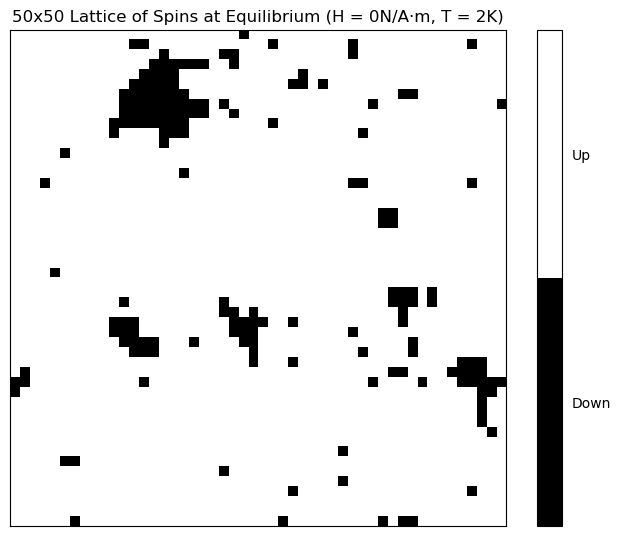

In [15]:
'''Plot orientation of the spins at equilibrium'''
c2.plot_spins(save_fig = True)

In [16]:
'''Animate the orientation of the spins during the algorithm'''
c2.animate_spins(save_fig = True)

##### For a large lattice, a large number of flips are required to occur in order to flip the sign of the magnetization.  Since the temperature of the system is near the critical temperature, there will be large fluctuations.  Because the system is in the ferromagnetic phase and because the system begins with all the spins oriented up, the sign of the magnetization should not change.  For $L=50$ and $T=2\text{K}$, we found that the sign of the average magnetization per particle did not change during the simulation with $n=100000$.  At equilibrium, we found the average magnetization per particle to be $\langle m\rangle=0.8454\text{A/m}$.  While the magnetization per particle did decrease during the simulation, a majority of the spins were still oriented up.  Lastly, we found small regions of spin down orientations at equilibrium due to fluctuations.

##### Since the temperature of the system is near the critical temperature, $T=2\text{K}\approx T_c\approx2.269\text{K}$, we will begin to see large fluctuations because the system is nearing the phase-transition from ferromagnetic to paramagnetic.  Theoretically, there should be a preferred direction of the spins since the temperature of the system is below the critical temperature, so we are still in the ferromagnetic phase.  In both cases of $L\approx1$ and $L\gg1$, we found that there was a preferred direction at equilibrium.  For the small lattice, we found that the fluctuations in the system caused the magnetization per particle to change signs during the simulation.  For the large lattice, we found that the preferred direction of the spins was consistent during the simulation.

#### (d) Set $L=32$.  Start at $T=4$ and determine the temperature dependence of $m$, the zero-field susceptibility $\chi$, the mean energy per spin $E/N$, and the specific heat $C$.  Decrease the temperature in intervals of $0.2$ until $T\approx1.6$, equilibrating for at least $1000$ mcs before collecting data at each value of $T$.  Describe the qualitative temperature dependence of these quantities.  (When the simulation is stopped, the mean magnetization and the mean of the absolute value of the magnetization is returned.)  Because $M$ sometimes changes sign for small systems, the value of $\langle\vert m\vert\rangle$ is a more accurate representation of the magnetization.  For this reason the susceptibility is given by $\chi=\left[\langle M^2\rangle-\langle\vert M\vert\rangle^2\right]/kT$, rather than by (5.28).

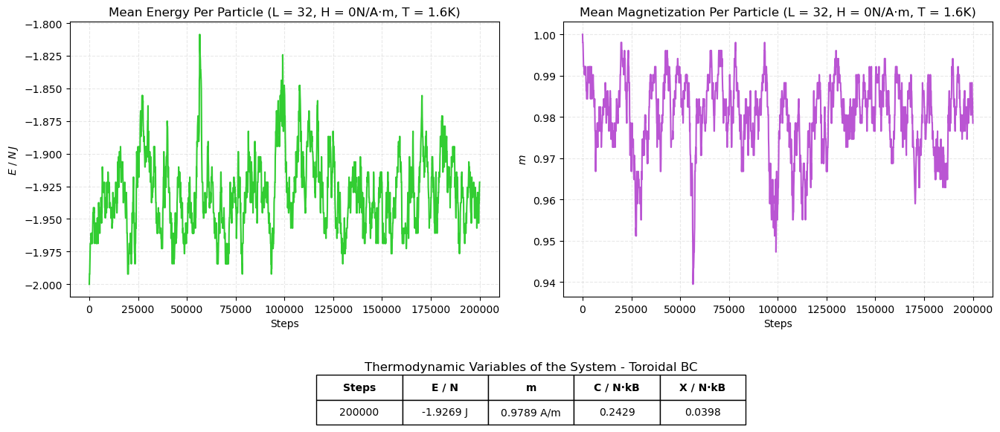

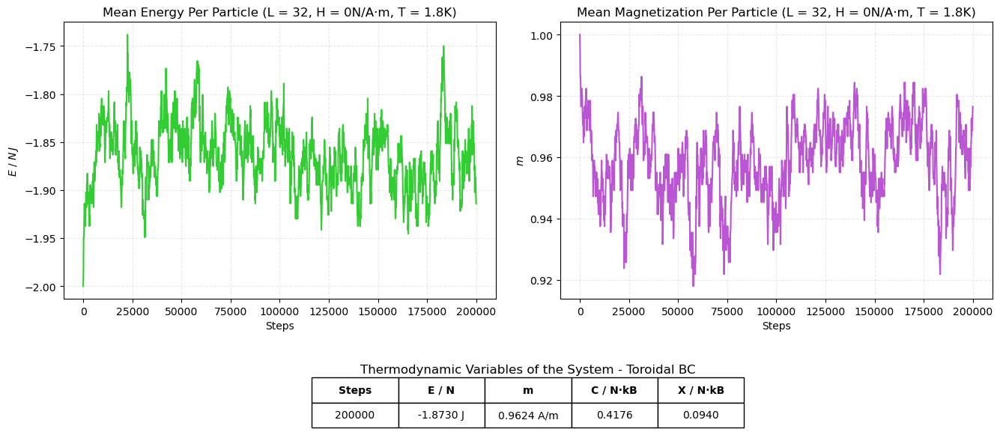

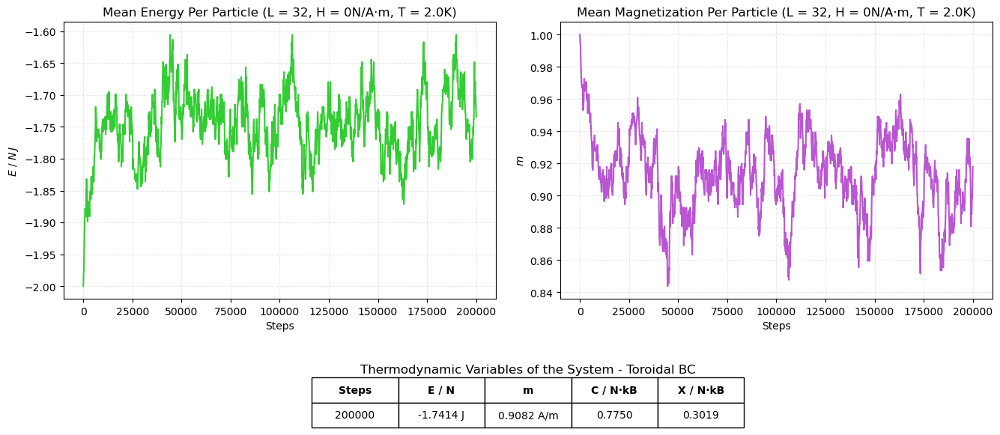

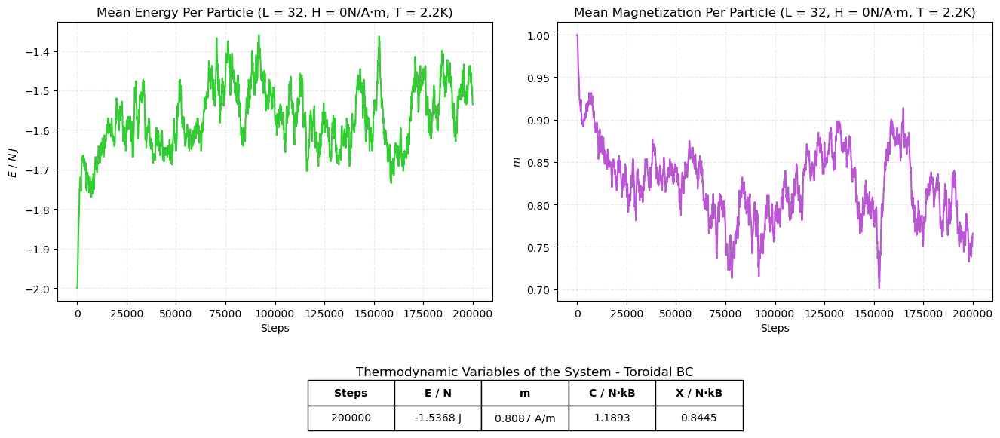

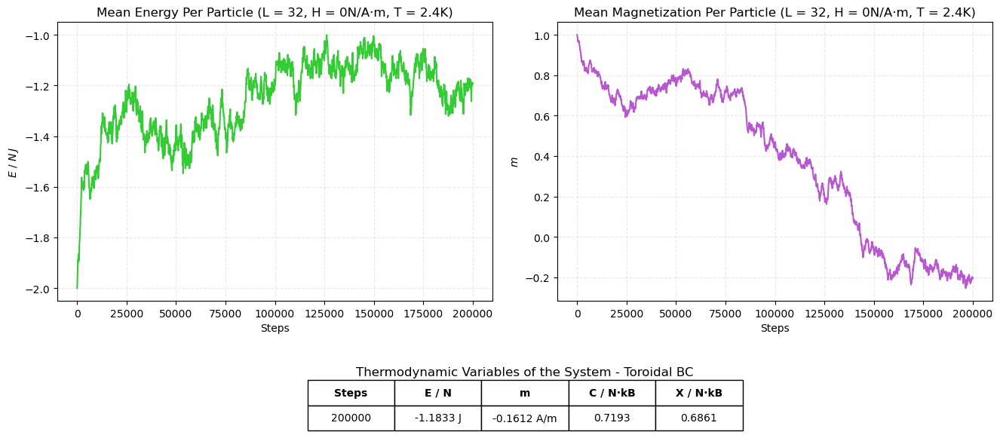

...

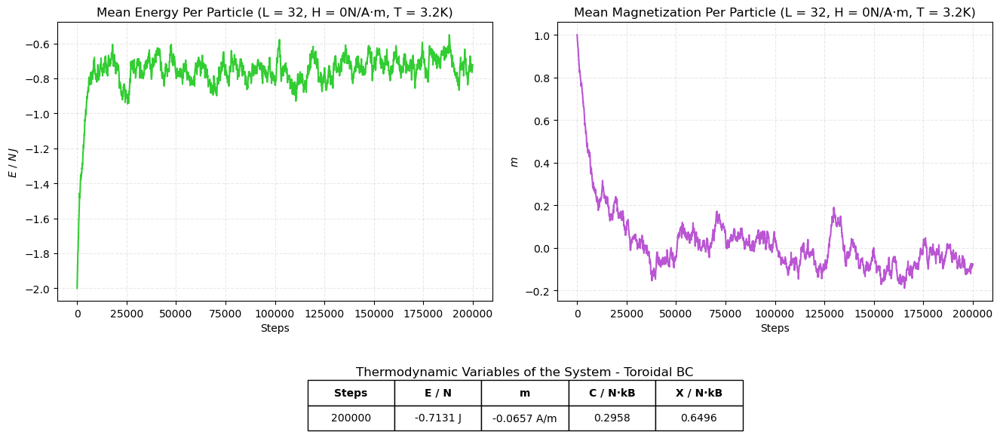

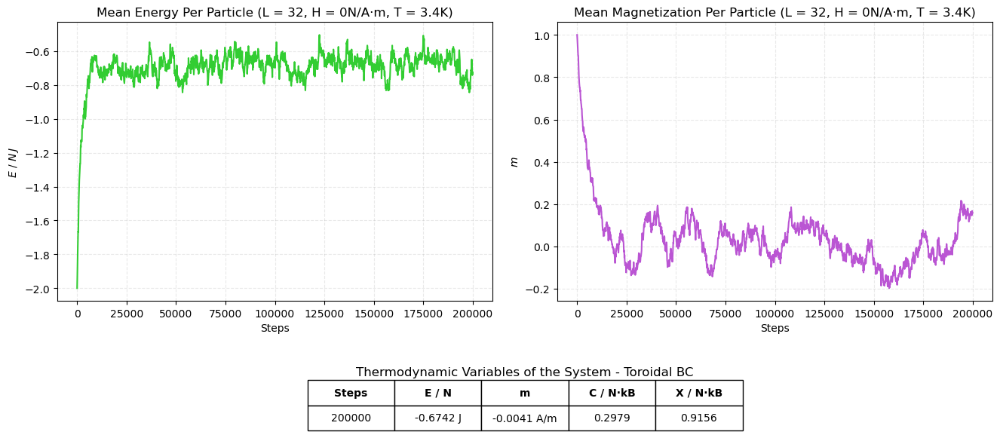

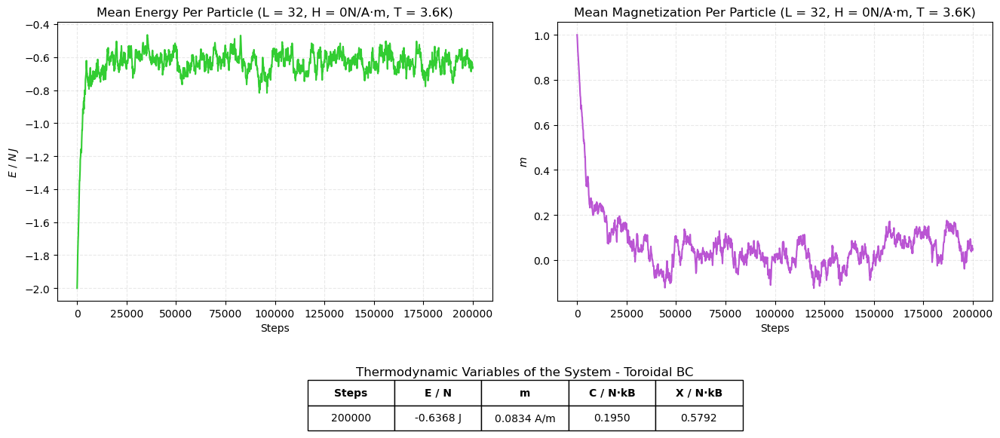

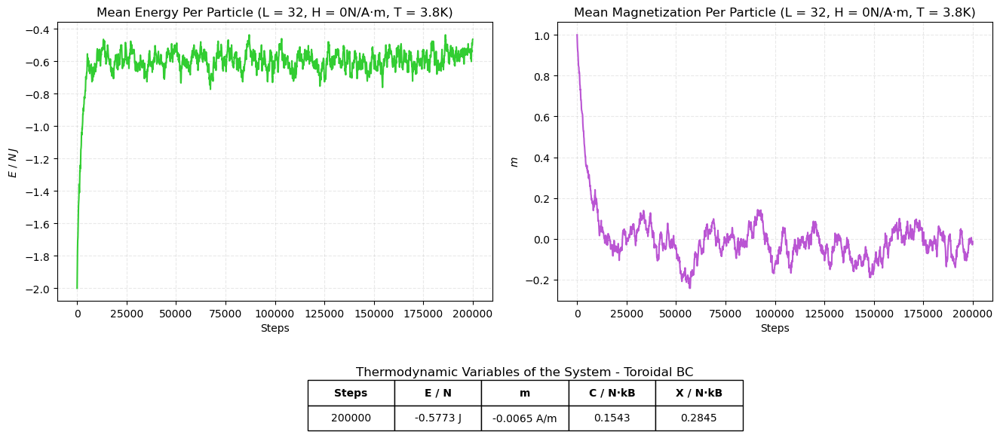

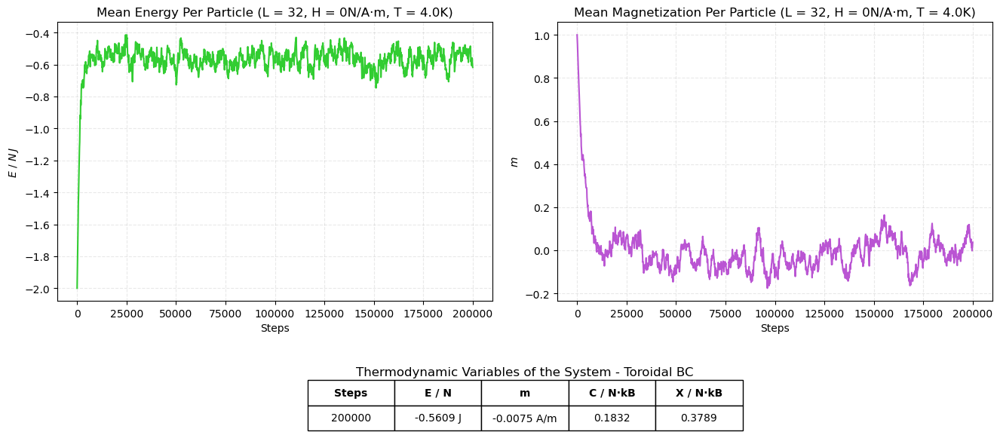

In [17]:
'''Set the system parameters'''
L = 32      #size of the lattice
H = 0       #external magnetic field [N / A * m]
n = 200000  #number of steps for the Metropolis algorithm

'''Set the range of temperatures to evaluate [K]'''
temps1 = [1.6, 1.8, 2.0, 2.2, 2.4, 2.6, 2.8, 3.0, 3.2, 3.4, 3.6, 3.8, 4.0]

'''Set lists to store the thermodynamic variables for each trial'''
e_tot, m_tot, C_tot, X_tot = [], [], [], []

'''Conduct ten trials at each temperature to find averages and errors'''
for trial in range(10):
    
    '''Store variables for each trial'''
    e_trial, m_trial, C_trial, X_trial = [], [], [], []
    
    '''Evaluate each temperature'''
    for T in temps1:
        
        '''Create an instance of the class and conduct the Metropolis algorithm'''
        d = Ising2D(L, H, T, 'Toroidal')
        d.Metropolis(n)
        
        '''Append the variables for each temperature'''
        e_trial.append(d.e)
        m_trial.append(d.m)
        C_trial.append(d.C)
        X_trial.append(d.X)
        
        '''Plot the thermodynamic variables for the first trial'''
        if trial == 0:
            d.plot_em()
        
    '''Append the lists for each trial'''
    e_tot.append(e_trial)
    m_tot.append(m_trial)
    C_tot.append(C_trial)
    X_tot.append(X_trial)
    
'''Find the average and standard error for each temperature'''
e_avg, e_err = np.average(e_tot, axis = 0), np.std(e_tot, axis = 0) / np.sqrt(10)
m_avg, m_err = np.average(m_tot, axis = 0), np.std(m_tot, axis = 0) / np.sqrt(10)
C_avg, C_err = np.average(C_tot, axis = 0), np.std(C_tot, axis = 0) / np.sqrt(10)
X_avg, X_err = np.average(X_tot, axis = 0), np.std(X_tot, axis = 0) / np.sqrt(10)

##### Note that the exact solution of the mean energy per particle is given by $$\frac{E}{NJ}=-2\tanh2\beta J-\frac{\sinh^22\beta J-1}{\sinh2\beta J\cosh2\beta J}\left[\frac{2}{\pi}K_1(\kappa)-1\right],\text{ where }K_1(\kappa)=\int_0^{\pi/2}\frac{d\phi}{\sqrt{1-\kappa^2\sin^2\phi}}\text{ and }\kappa=2\frac{\sinh2\beta J}{(\cosh2\beta J)^2}.$$

##### Next, the exact solution of the mean magnetization per particle is given by $$m=\big(1-[\sinh2\beta J]^{-4}\big)^{1/8}\text{ if }T<T_c\text{ and }m=0\text{ if }T>T_c.$$

##### Lastly, the exact solution of the heat capacity per particle is given by $$\frac{C}{Nk_B}=\frac{(2\beta J\coth2\beta J)^2}{\pi}\left[K_1(\kappa)-E_1(\kappa)-(1-(\tanh2\beta J)^2)\big(\frac{\pi}{2}+(2(\tanh2\beta J)^2-1)K_1(\kappa)\big)\right]\text{ where }E_1(\kappa)=\int_0^{\pi/2}d\phi\sqrt{1-\kappa^2\sin^2\phi}.$$

##### Currently, there is no exact solution of the zero-field susceptibility.  In the following cell, we define the functions necessary to calculate the exact solutions of the thermodynamic variables for the given range of temperatures.

In [18]:
'''Set the constants of the system'''
J = 1                            #interaction energy [J]
kB = 1                           #Boltzmann's constant [J / K]
Tc = 2 / np.log(1 + np.sqrt(2))  #critical temperature [K]

'''Function to calculate the exact energy per particle for a given temperature'''
def energy(T):
    x = 2 * J / (kB * T)
    k = 2 * np.sinh(x) / np.cosh(x)**2
    K1 = ellipk(k)
    E_NJ = -2 * np.tanh(x) - ((np.sinh(x)**2 - 1) * ((2 * K1 / np.pi) - 1) / (np.sinh(x) * np.cosh(x)))
    return E_NJ

'''Function to calculate the exact magnetization per particle for a given temperature'''
def magnetization(T):
    x = 2 * J / (kB * T)
    if T < Tc:
        m = (1 - np.sinh(x)**-4)**(1 / 8)
    else:
        m = 0
    return m

'''Function to calculate the exact heat capacity per particle for a given temperature'''
def heat_capacity(T):
    x = 2 * J / (kB * T)
    k = 2 * np.sinh(x) / (np.cosh(x)**2)
    K1 = ellipk(k)
    E1 = ellipe(k)
    C_NkB = ((x / (np.tanh(x))**2 / 2)) * (K1 - E1 - (1 - np.tanh(x)**2) * ((np.pi / 2) +
            (2 * np.tanh(x)**2 - 1) * K1)) / np.pi
    return C_NkB

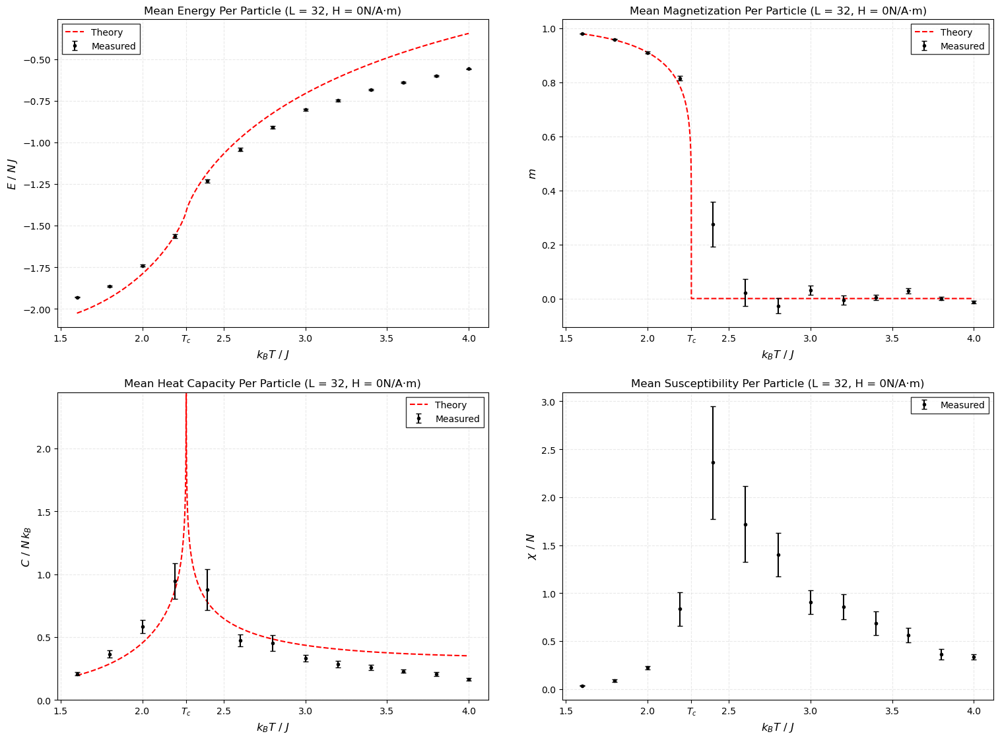

In [19]:
'''Set the range of temperatures to calculate the exact solutions [K]'''
temps2 = np.linspace(1.6, 4.0, 10000)

'''Calculate the exact solutions of the thermodynamic variables'''
e_theory = [energy(T) for T in temps2]
m_theory = [magnetization(T) for T in temps2]
C_theory = [heat_capacity(T) for T in temps2]

'''Create figure'''
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize = (16, 12), gridspec_kw = {'width_ratios': [1, 1],
                                                                                     'height_ratios': [1, 1]})
fig.tight_layout(pad = 5)
for ax in [ax1, ax2, ax3, ax4]:
    ax.set_xlabel('$k_BT\ /\ J$', fontsize = 12)
    ax.set_xticks([1.5, 2, Tc, 2.5, 3, 3.5, 4])
    ax.set_xticklabels(['1.5', '2.0', '$T_c$', '2.5', '3.0', '3.5', '4.0'])
    ax.grid(True, linestyle = 'dashed', color = 'darkgray', alpha = 0.25)
    
'''First figure --> E / NJ'''
ax1.set_ylabel('$E\ /\ N\,J$', fontsize = 12)
ax1.set_title(f'Mean Energy Per Particle (L = {L}, H = {H}N/A\u00B7m)')
ax1.plot(temps2, e_theory, linestyle = 'dashed', color = 'red', label = 'Theory')
ax1.errorbar(temps1, e_avg, yerr = e_err, capsize = 3, fmt = 'k.', zorder = 5, label = 'Measured')
legend1 = ax1.legend(loc='upper left', fancybox = False)
frame1 = legend1.get_frame()
frame1.set_facecolor('white')
frame1.set_edgecolor('black')
frame1.set_linewidth(1)

'''Second figure --> m'''
ax2.set_ylabel('$m$', fontsize = 12)
ax2.set_title(f'Mean Magnetization Per Particle (L = {L}, H = {H}N/A\u00B7m)')
ax2.plot(temps2, m_theory, linestyle = 'dashed', color = 'red', label = 'Theory')
ax2.errorbar(temps1, m_avg, yerr = m_err, capsize = 3, fmt = 'k.', zorder = 5, label = 'Measured')
legend2 = ax2.legend(loc='upper right', fancybox = False)
frame2 = legend2.get_frame()
frame2.set_facecolor('white')
frame2.set_edgecolor('black')
frame2.set_linewidth(1)

'''Third figure --> C / N kB'''
ax3.set_ylabel('$C\ /\ N\,k_B$', fontsize = 12)
ax3.set_title(f'Mean Heat Capacity Per Particle (L = {L}, H = {H}N/A\u00B7m)')
ax3.set_ylim([0, max(C_avg) + 1.5])
ax3.plot(temps2, C_theory, linestyle = 'dashed', color = 'red', label = 'Theory')
ax3.errorbar(temps1, C_avg, yerr = C_err, capsize = 3, fmt = 'k.', zorder = 5, label = 'Measured')
legend3 = ax3.legend(loc='upper right', fancybox = False)
frame3 = legend3.get_frame()
frame3.set_facecolor('white')
frame3.set_edgecolor('black')
frame3.set_linewidth(1)

'''Fourth figure --> E / N'''
ax4.set_ylabel('$\chi\ /\ N$', fontsize = 12)
ax4.set_title(f'Mean Susceptibility Per Particle (L = {L}, H = {H}N/A\u00B7m)')
ax4.errorbar(temps1, X_avg, yerr = X_err, capsize = 3, fmt = 'k.', zorder = 5, label = 'Measured')
legend4 = ax4.legend(loc='upper right', fancybox = False)
frame4 = legend4.get_frame()
frame4.set_facecolor('white')
frame4.set_edgecolor('black')
frame4.set_linewidth(1)

'''Save figure'''
fig.savefig('c:/Users/Tucker Knaak/Downloads/1024Spins_H0_VaryingT_emcX_Toroidal.png', bbox_inches = 'tight')

##### (1) We found that simulated results of the average energy per particle matched those of the exact solution.  The average energy per particle is approximately $-2\text{J}$ at low temperatures as expected since there is a preferred direction in the ferromagnetic phase.  As the temperature becomes higher than the critical temperature, the average energy per particle approaches $0\text{J}$ as expected since the spins are now randomly oriented in the paramagnetic phase.

##### (2) We found that the simulated results of the average magnetization per particle matched those of the exact solution.  The average magnetization per particle is approximately $1\text{A/m}$ at low temperatures as expected since there is a preferred direction in the ferromagnetic phase.  As the temperature becomes higher than the critical temperature, the average magnetization per particle approaches $0\text{A/m}$ as expected since the spins are now randomly oriented in the paramagnetic phase.

##### (3) We found that the simulated results of the average heat capacity per particle matched those of the exact solution.  The average heat capacity is approximately $0$ at both low and high temperatures as expected.  If we are in the ferromagnetic phase at low temperatures, then the small fluctuations from an increase in temperature will not cause a large change in energy since a majority of the spins are aligned with one another.  Similarly, if we are in the paramagnetic phase at high temperatures, then the extra fluctuations from an increase in temperature will not cause a large change in energy since the spins are already randomly oriented.  However, if we are near the phase transition at the critical temperature, then a small increase in temperature will cause large fluctuations and thus large changes in the energy.

##### (4) While there is no exact solution for the susceptibility, we found that the simulated results of the average susceptibility per particle were consistent with the theory.  We note that the susceptibility is a measure of the change of the magnetization.  The average susceptibility per particle is approximately $0$ at both low and high temperatures as expected.  If we are in the ferromagnetic phase at low temperatures, then there is a preferred direction of the spins, so an increase in temperature will not cause a large change in the magnetization.  Similarly, if we are in the paramagnetic phase at high temperatures, then the spins are randomly oriented, so an increase in temperature will also not cause a large change in the magnetization.  However, if we are near the phase transition at the critical temperature, then a small increase in the temperature will cause a large change in the magnetization.

#### (e) Set $T=T_c\approx2.269$ and choose $L\geq128$.  Obtain $\langle m\rangle$ for $H=0.01,\ 0.02,\ 0.04,\ 0.08,\text{ and }0.16$.  Make sure you equilibrate the system at each value of $H$ before collecting data.  Make a log-log plot of $m$ versus $H$ and estimate the critical exponent $\delta$ using (5.88).  A method for estimating the critical exponents $\alpha,\ \beta,\text{ and }\gamma$ is discussed in Problem 5.38.

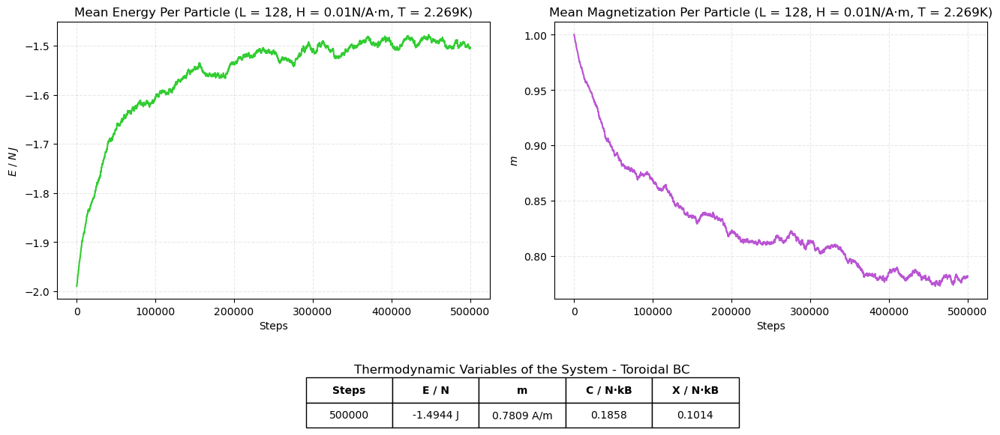

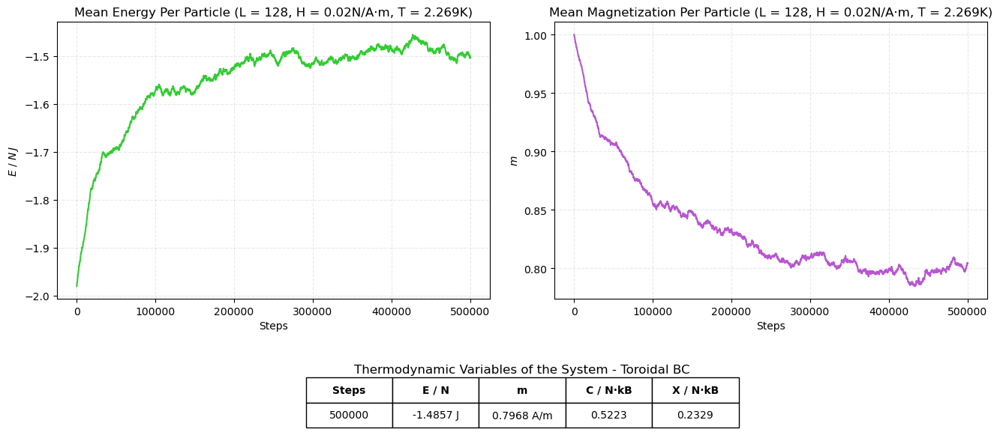

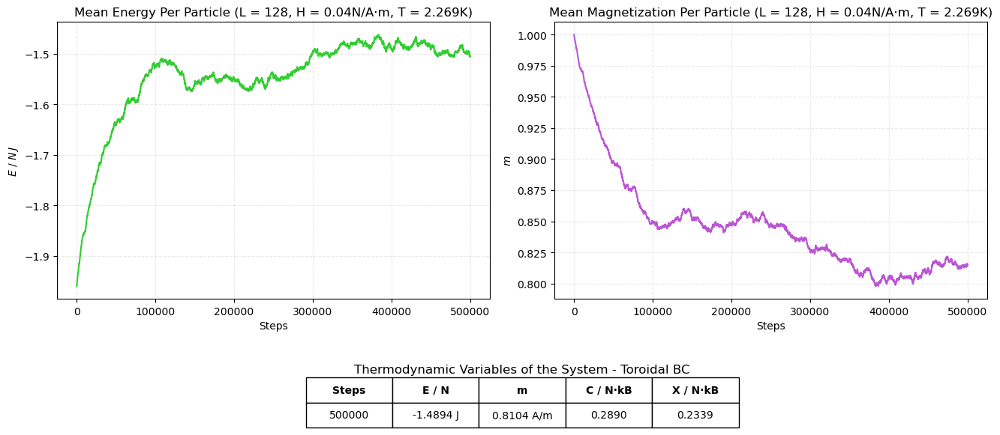

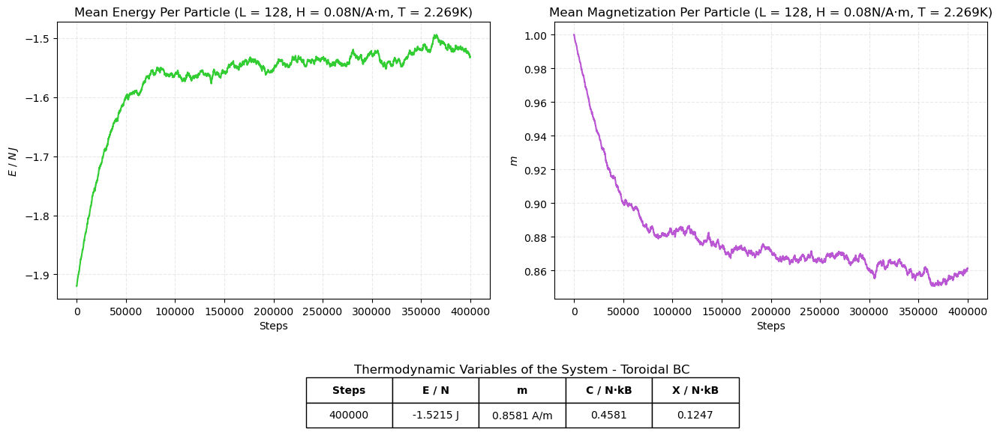

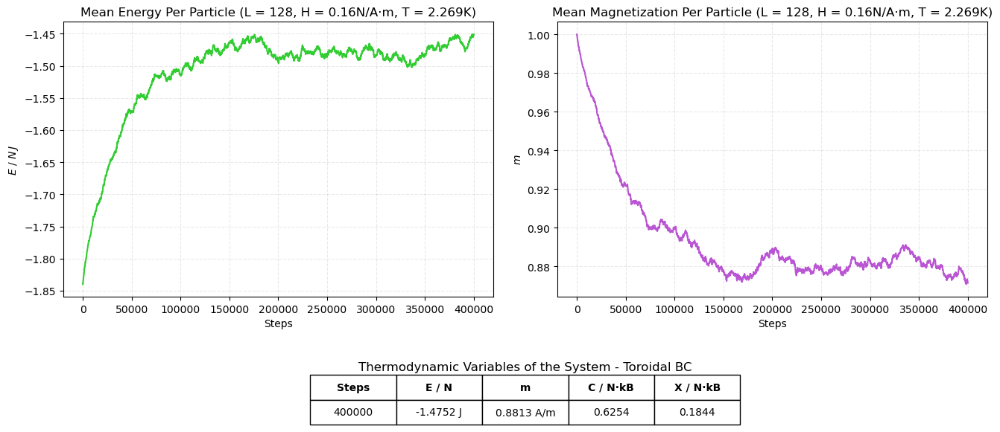

In [20]:
'''Set the system parameters'''
L = 128      #size of the lattice
T = 2.269    #temperature of the system [K]
n1 = 500000  #number of steps for the Metropolis algorithm for H = 0.01, 0.02, 0.04
n2 = 400000  #number of steps for the Metropolis algorithm for H = 0.08, 0.16

'''Set the range of external magnetic fields to evaluate [N / A * m]'''
fields1 = [0.01, 0.02, 0.04, 0.08, 0.16]

'''Set list to store the magnetization for each trial'''
m_tot = []

'''Conduct ten trials at each field to find averages and errors'''
for trial in range(10):
    
    '''Store variables for each trial'''
    m_trial = []
    
    '''Evaluate each temperature'''
    for H in fields1:
        
        '''Set number of steps'''
        if H == 0.01 or H == 0.02 or H == 0.04:
            n = n1
        else:
            n = n2
        
        '''Create an instance of the class and conduct the Metropolis algorithm'''
        e = Ising2D(L, H, T, 'Toroidal')
        e.Metropolis(n)
        
        '''Append the magnetization for each field'''
        m_trial.append(e.m)
        
        '''Plot the thermodynamic variables for the first trial'''
        if trial == 0:
            e.plot_em()
        
    '''Append the lists for each trial'''
    m_tot.append(m_trial)
    
'''Find the average and standard error for each field'''
m_avg, m_err = np.average(m_tot, axis = 0), np.std(m_tot, axis = 0) / np.sqrt(10)

##### In the following cell, we use the scipy library to conduct a non-linear ODR fit of the average magnetization per particle versus the external magnetic field to find the critical exponent $\delta$.  The exact solution is given by $\vert m\vert=\vert H\vert^{1/15}$.

The best-fit critical exponent is δ = 15.34 ± 0.23.


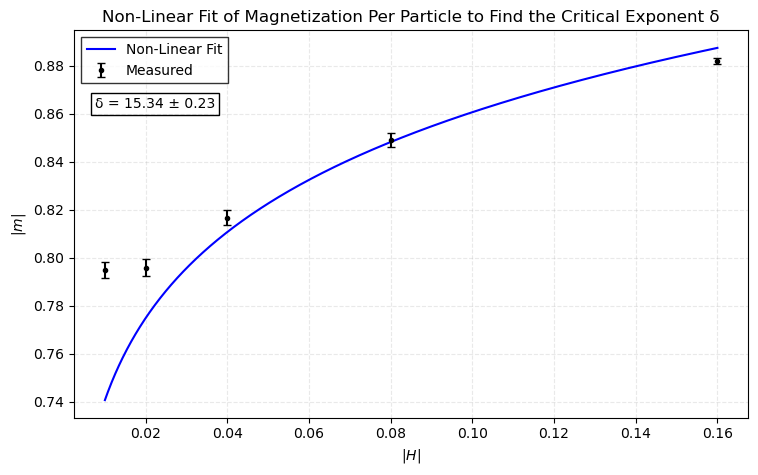

In [21]:
'''Function to calculate the magnetization per particle'''
def magnetization(params: list, H):
    m = np.abs(H)**(1 / params[0])
    return m

'''Non-linear fit to find critical exponent for |m|~|H|^1/delta'''
data = RealData(fields1, m_avg, sy = m_err)
model = Model(magnetization)
pguess = [15]
odr = ODR(data, model, pguess)
output = odr.run()
delta, delta_err = output.beta[0], output.sd_beta[0] / np.sqrt(5)

'''Print best-fit data'''
print(f'The best-fit critical exponent is \u03B4 = {delta:.2f} \u00B1 {delta_err:.2f}.')

'''Set the range of fields to calculate the exact solutions [N / A * m]'''
fields2 = np.linspace(0.01, 0.16, 1000)

'''Create figure and plot results'''
fig, ax = plt.subplots(1, 1, figsize = (8, 5))
fig.tight_layout(pad = 3)
ax.set_xlabel('$|H|$')
ax.set_ylabel('$|m|$')
ax.set_title('Non-Linear Fit of Magnetization Per Particle to Find the Critical Exponent \u03B4')
ax.grid(True, which = 'both', linestyle = 'dashed', color = 'darkgray', alpha = 0.25)
ax.plot(fields2, magnetization(output.beta, fields2), linestyle = 'solid', color = 'blue', label = 'Non-Linear Fit')
ax.errorbar(fields1, m_avg, yerr = m_err, capsize = 3, fmt = 'k.', zorder = 5, label = 'Measured')
ax.annotate(f'\u03B4 = {delta:.2f} \u00B1 {delta_err:.2f}', xy = (0.12, 0.81), xycoords = 'axes fraction',
            ha = 'center', va = 'center', bbox = dict(boxstyle = 'square', edgecolor = 'black', facecolor = 'none'))
legend = ax.legend(loc = 'upper left', fancybox = False)
frame = legend.get_frame()
frame.set_facecolor('white')
frame.set_edgecolor('black')
frame.set_linewidth(1)

'''Save figure'''
fig.savefig('c:/Users/Tucker Knaak/Downloads/Magnetization_VaryingH_NonLinearFit_Toroidal.png', bbox_inches = 'tight')

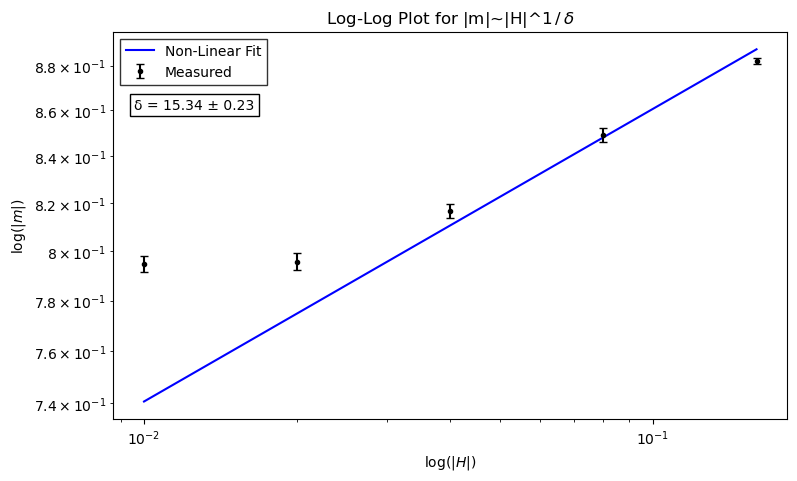

In [22]:
'''Create figure and make log-log plot'''
fig, ax = plt.subplots(1, 1, figsize = (8, 5))
fig.tight_layout(pad = 3)
ax.set_xlabel('log($|H|$)')
ax.set_ylabel('log($|m|$)')
ax.set_title('Log-Log Plot for |m|~|H|^${1\,/\,\u03B4}$')
ax.set_xscale('log')
ax.set_yscale('log')
ax.plot(fields2, magnetization(output.beta, fields2), linestyle = 'solid', color = 'blue', label = 'Non-Linear Fit')
ax.errorbar(fields1, m_avg, yerr = m_err, capsize = 3, fmt = 'k.', zorder = 5, label = 'Measured')
ax.annotate(f'\u03B4 = {delta:.2f} \u00B1 {delta_err:.2f}', xy = (0.12, 0.81), xycoords = 'axes fraction',
            ha = 'center', va = 'center', bbox = dict(boxstyle = 'square', edgecolor = 'black', facecolor = 'none'))
legend = ax.legend(loc = 'upper left', fancybox = False)
frame = legend.get_frame()
frame.set_facecolor('white')
frame.set_edgecolor('black')
frame.set_linewidth(1)

'''Save figure'''
fig.savefig('c:/Users/Tucker Knaak/Downloads/Magnetization_VaryingH_LogLogPlot_Toroidal.png', bbox_inches = 'tight')

##### At the critical temperature $T_c\approx2.269\text{K}$, we know that the magnetization per particle varies with the external magnetic field as $\vert m\vert=\vert H\vert^{1/\delta}$, where $\delta=15$.  From the non-linear ODR fit, we found $\delta=15.34\pm0.23$, which matches the expected value of the critical exponent.  As the external magnetic field is increased, the average magnetization per particle is also increased, which implies that the spins become more aligned with one another.  That is, there is a more definite preferred direction of the spins as the external magnetic field is increased.

### Extension Problem.  "Box" Boundary Conditions.

#### (a) Choose $T=10$ and run until equilibrium has been established.  Is the orientation of the spins random and the mean magnetization approximately equal to zero?  What is a typical size of a domain (a region of parallel spins)?

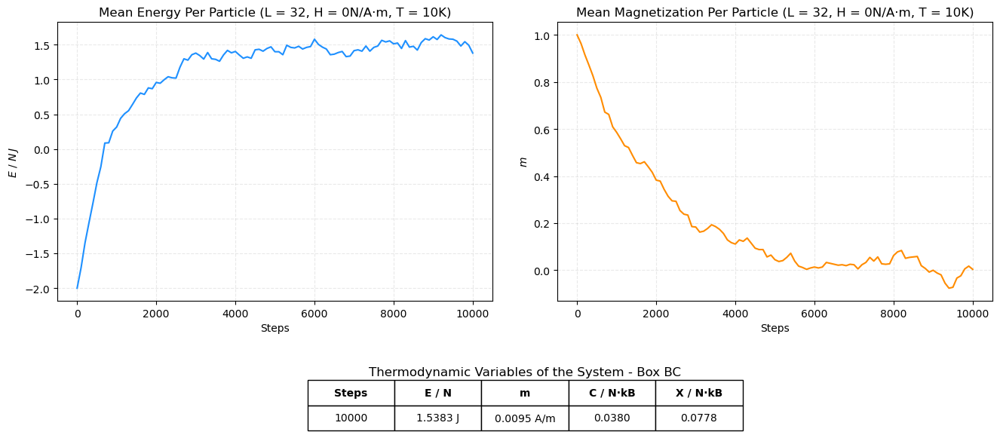

In [24]:
'''Set the system parameters'''
L = 32     #size of the lattice
H = 0      #external magnetic field [N / A * m]
T = 10     #temperature of the system [K]
n = 10000  #number of steps for the Metropolis algorithm

'''Create an instance of the class and conduct the Metropolis algorithm'''
a = Ising2D(L, H, T, 'Box')
a.Metropolis(n, save_spins = True)

'''Plot the relevant thermodynamic variables'''
a.plot_em(save_fig = True)

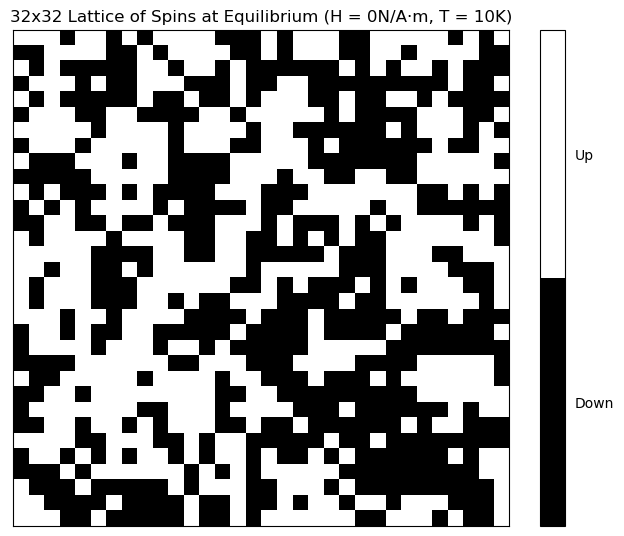

In [25]:
'''Plot orientation of the spins at equilibrium'''
a.plot_spins(save_fig = True)

In [26]:
'''Animate the orientation of the spins during the algorithm'''
a.animate_spins(save_fig = True)

##### In this simulation with $n=10000$ steps, we found the average magnetization per particle to be $\langle m\rangle=0.0095\text{A/m}$ as expected.  We also found that the average domain size is approximately $3\times3$.  These are precisely the same results found by using the Toroidal Boundary Conditions.  However, the average energy per particle for the Box BC is much different than that for the Toroidal BC.  We found the average energy per particle to be $1.5383\text{J}$ for the Box BC, whereas we found the average energy per particle to be $-0.2044\text{J}$ for the Toroidal BC.  As we increased the number of spins that interact with any given spin, we found an increase in the average energy per particle.  We also found that it took a longer number of steps ($\approx3000$) to reach equilibrium for the Box BC compared to that of the Toroidal BC ($\approx1000$)

#### (b) Choose a low temperature such as $T=0.75$.  Are the spins still random or is there a preferred direction?  You will notice that $\langle M\rangle\approx0$ for sufficiently high $T$ and $\langle M\rangle\neq0$ for suffiently low $T$.  Hence, there is an intermediate value of $T$ at which $\langle M\rangle$ first becomes nonzero.

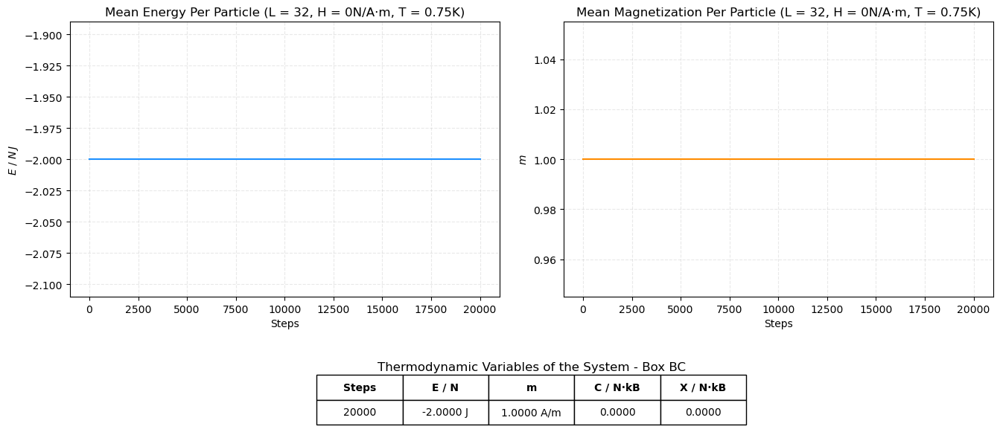

In [28]:
'''Set the system parameters'''
L = 32     #size of the lattice
H = 0      #external magnetic field [N / A * m]
T = 0.75   #temperature of the system [K]
n = 20000  #number of steps for the Metropolis algorithm

'''Create an instance of the class and conduct the Metropolis algorithm'''
b = Ising2D(L, H, T, 'Box')
b.Metropolis(n, save_spins = True)

'''Plot the relevant thermodynamic variables'''
b.plot_em(save_fig = True)

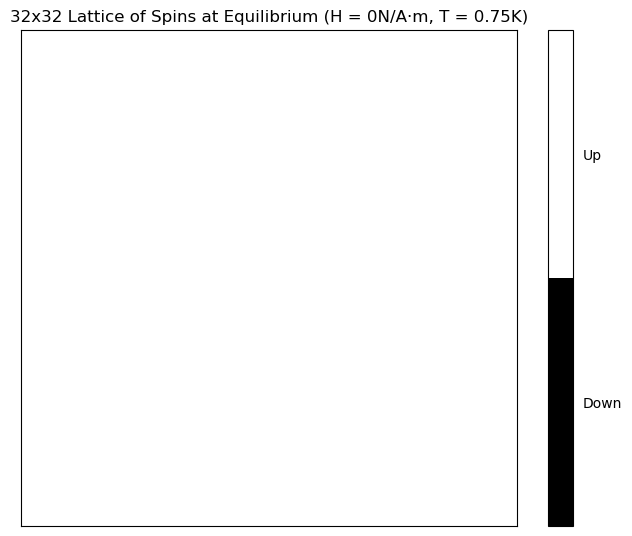

In [29]:
'''Plot orientation of the spins at equilibrium'''
b.plot_spins(save_fig = True)

In [30]:
'''Animate the orientation of the spins during the algorithm'''
b.animate_spins(save_fig = True)

##### In this simulation with $n=20000$ steps, we found the average magnetization per particle to be $\langle m\rangle=1.000$ as expected.  This shows that each spin on the lattice is oriented up and that there is a definite preferred direction.  This is precisely the same results found by the Toroidal Boundary Conditions.  However, while the Toroidal Boundary Conditions showed that there could be minor fluctuations in the system during the simulation, the Box Boundary Conditions had no fluctuations, and none of the spins flipped during the system.  In the Metropolis algorithm, a spin is flipped if the change in energy is negative or if a randomly chosen float is less than $e^{-\Delta E/k_BT}$.  Since we have shown that the energy is greater for the Box Boundary Conditions, the probability of choosing a random float less than is exponential is near zero for low temperatures.  This implies that we will not find any fluctuations during the simulation.

#### (c) Choose $L=4$ and $T=2$.  Does the sign of $M$ change during the simulation?  Choose a larger value of $L$ and observe if the sign of $M$ changes.  Will the sign of $M$ change for $L\gg1$?  Should a theoretical calculation of $\langle M\rangle$ yield $\langle M\rangle\neq0$ or $\langle M\rangle=0$ for $T<T_c$?

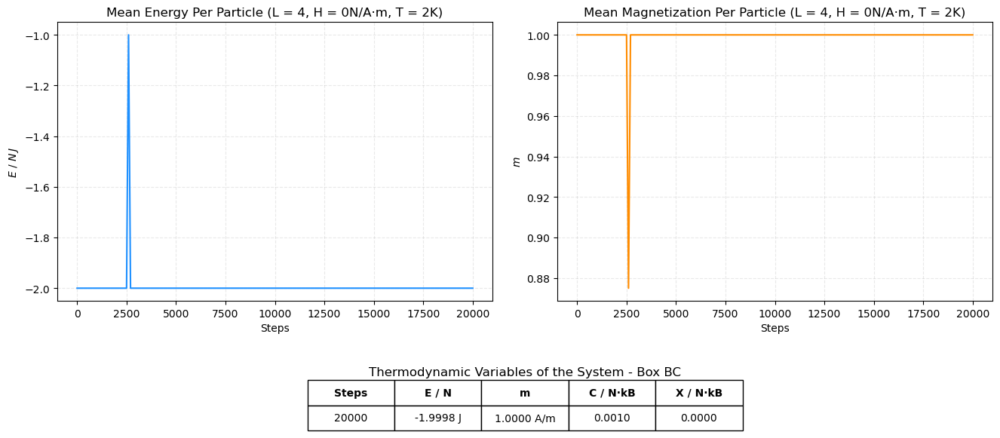

In [32]:
'''Set the system parameters'''
L1 = 4     #size of the lattice
H = 0      #external magnetic field [N / A * m]
T = 2      #temperature of the system [K]
n = 20000  #number of steps for the Metropolis algorithm

'''Create an instance of the class and conduct the Metropolis algorithm'''
c1 = Ising2D(L1, H, T, 'Box')
c1.Metropolis(n, save_spins = True)

'''Plot the relevant thermodynamic variables'''
c1.plot_em(save_fig = True)

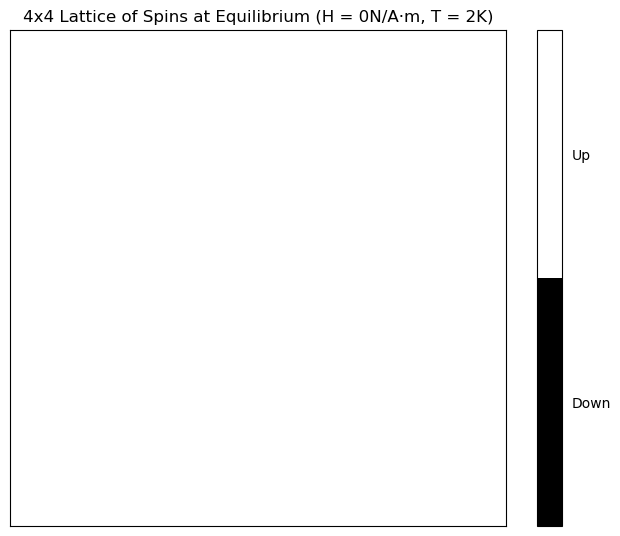

In [33]:
'''Plot orientation of the spins at equilibrium'''
c1.plot_spins(save_fig = True)

In [34]:
'''Animate the orientation of the spins during the algorithm'''
c1.animate_spins(save_fig = True)

##### For $L=4$ and $T=2\text{K}$, we found that the sign of the magnetization per particle did not change during the simulation with $n=20000$.  There was only one fluctuation of a spin flip which occurred during the simulation.  These results are the opposite of what we found for that of the Toroidal BC where the sign of the magnetization changed multiple times during the simulation.  Since we are still in the ferromagnetic phase, the larger energy for the Box BC makes the exponential term for flipping a spin in the Metropolis algorithm very close to zero.  Therefore, in the low temperature limit, we will not find fluctuations.

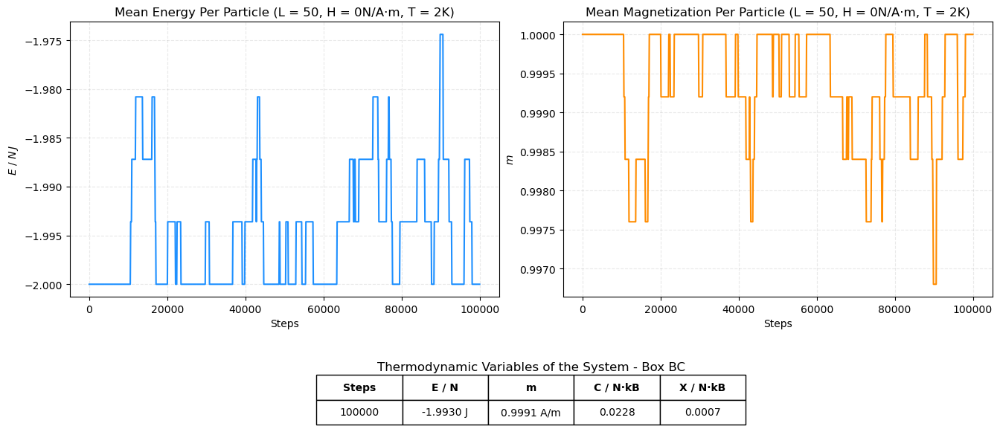

In [36]:
'''Set the system parameters'''
L2 = 50      #size of the lattice
H = 0        #external magnetic field [N / A * m]
T = 2        #temperature of the system [K]
n2 = 100000  #number of steps for the Metropolis algorithm

'''Create an instance of the class and conduct the Metropolis algorithm'''
c2 = Ising2D(L2, H, T, 'Box')
c2.Metropolis(n2, save_spins = True)

'''Plot the relevant thermodynamic variables'''
c2.plot_em(save_fig = True)

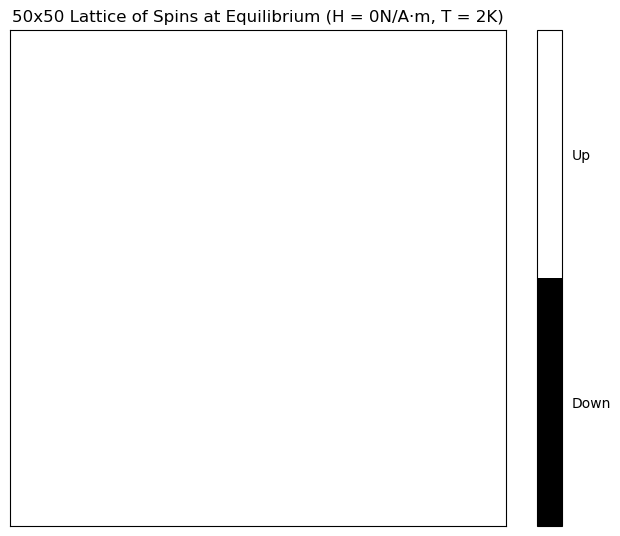

In [37]:
'''Plot orientation of the spins at equilibrium'''
c2.plot_spins(save_fig = True)

In [38]:
'''Animate the orientation of the spins during the algorithm'''
c2.animate_spins(save_fig = True)

##### For $L=50$ and $T=2\text{K}$, we found that the sign of the average magnetization per particle did not change during the simulation with $n=100000$.  The results with the Box BC showed a similar trend to those with the Toroidal BC.  For both boundary conditions, the average magnetization per particle decreased due to small fluctuations.  The Box BC had many less fluctuations, however, as also seen in the results for the smaller lattice.  At equilibrium, we found that all of the spins were flipped back to the initial orientation of spin up for the Box BC, which differed from that of the Toroidal BC.

##### Since the temperature of the system is near the critical temperature, $T=2\text{K}\approx T_c\approx2.269\text{K}$, we should begin to see fluctuations because the system is nearing the phase-transition from ferromagnetic to paramagnetic.  Theoretically, there should be a preferred direction of the spins since the temperature of the system is below the critical temperature, so we are still in the ferromagnetic phase.  In both cases of $L\approx1$ and $L\gg1$, we found that there was a preferred direction at equilibrium, such that all of the spins were oriented spin up.  We found that there were much less fluctuations during the simulation for the Box BC compared to those of the Toroidal BC, and we have attributed this to the previous discussion of the larger energy.

#### (d) Set $L=32$.  Start at $T=4$ and determine the temperature dependence of $m$, the zero-field susceptibility $\chi$, the mean energy per spin $E/N$, and the specific heat $C$.  Decrease the temperature in intervals of $0.2$ until $T\approx1.6$, equilibrating for at least $1000$ mcs before collecting data at each value of $T$.  Describe the qualitative temperature dependence of these quantities.  (When the simulation is stopped, the mean magnetization and the mean of the absolute value of the magnetization is returned.)  Because $M$ sometimes changes sign for small systems, the value of $\langle\vert m\vert\rangle$ is a more accurate representation of the magnetization.  For this reason the susceptibility is given by $\chi=\left[\langle M^2\rangle-\langle\vert M\vert\rangle^2\right]/kT$, rather than by (5.28).

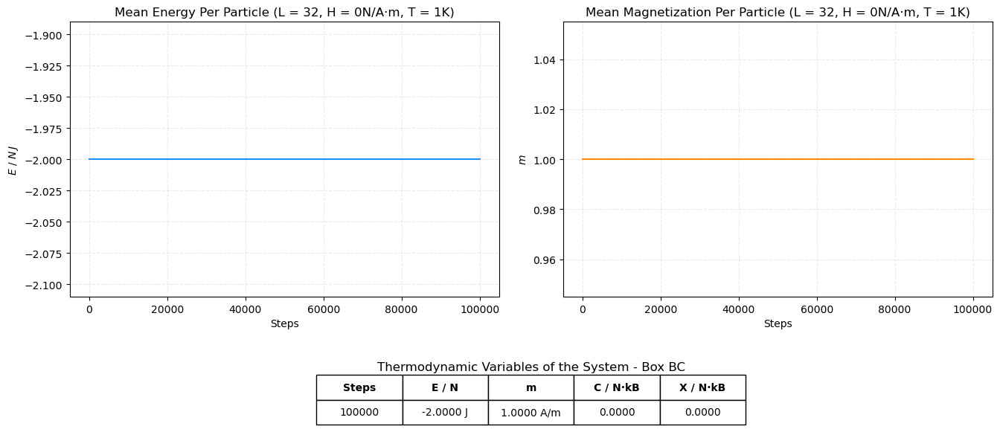

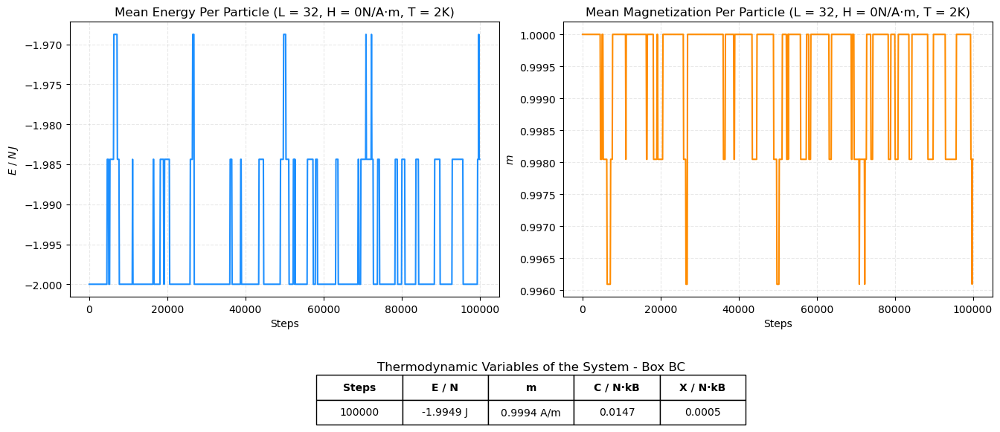

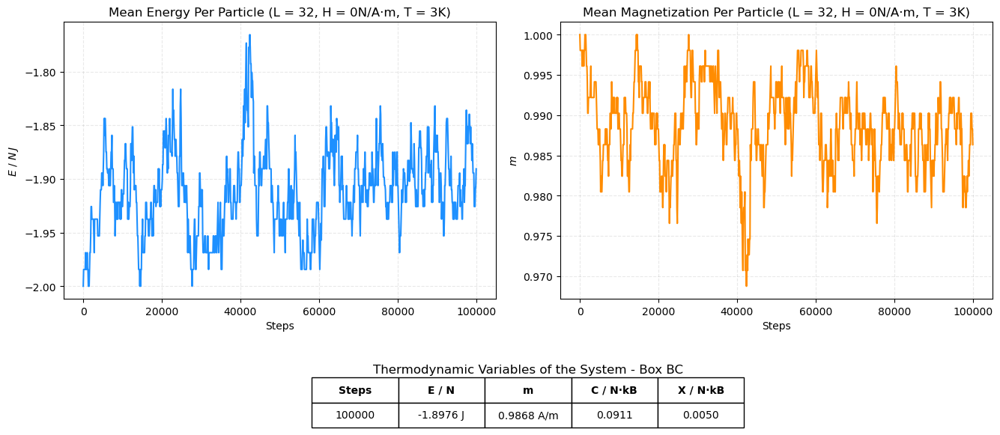

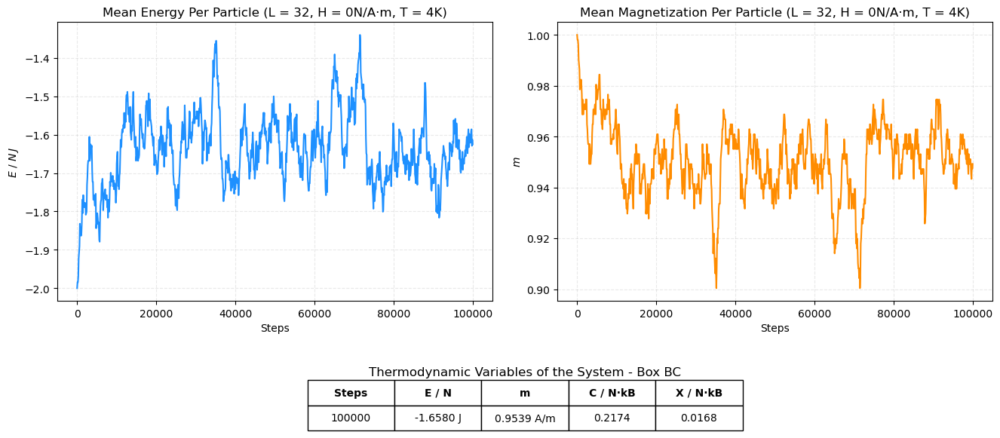

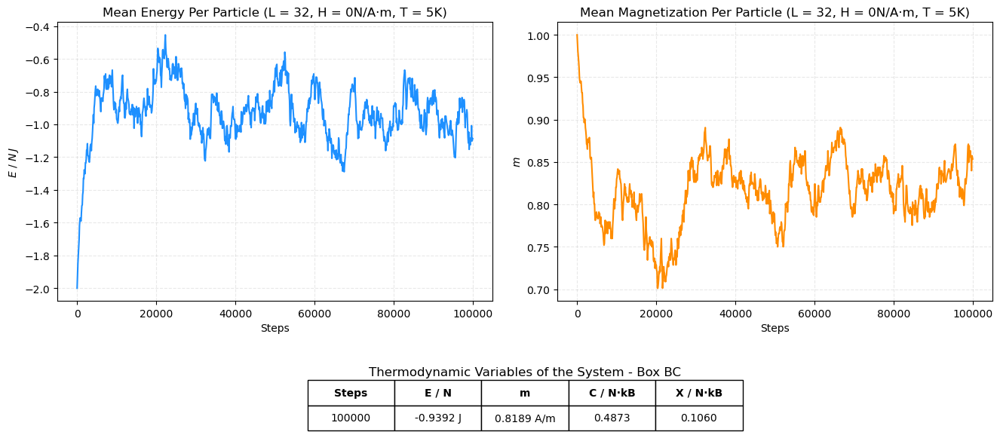

...

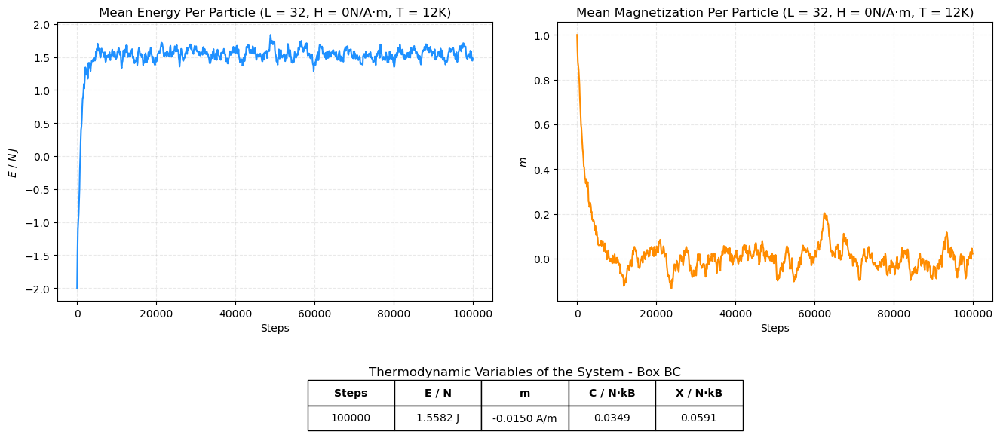

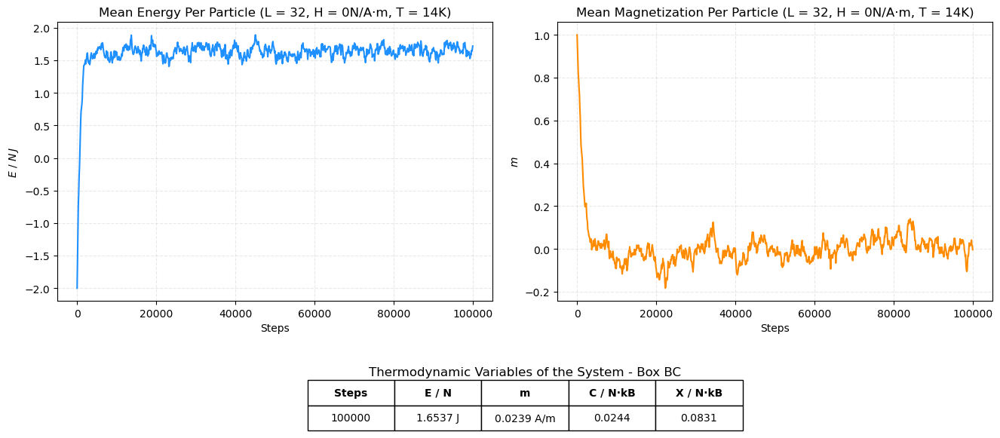

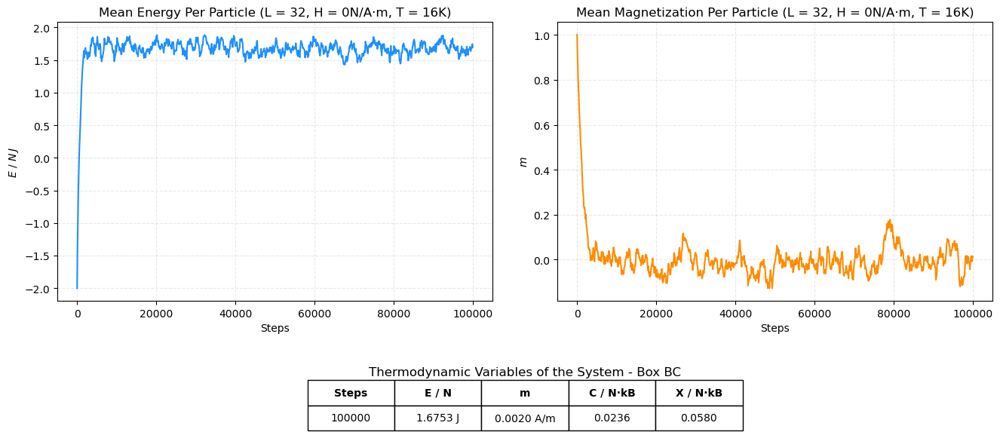

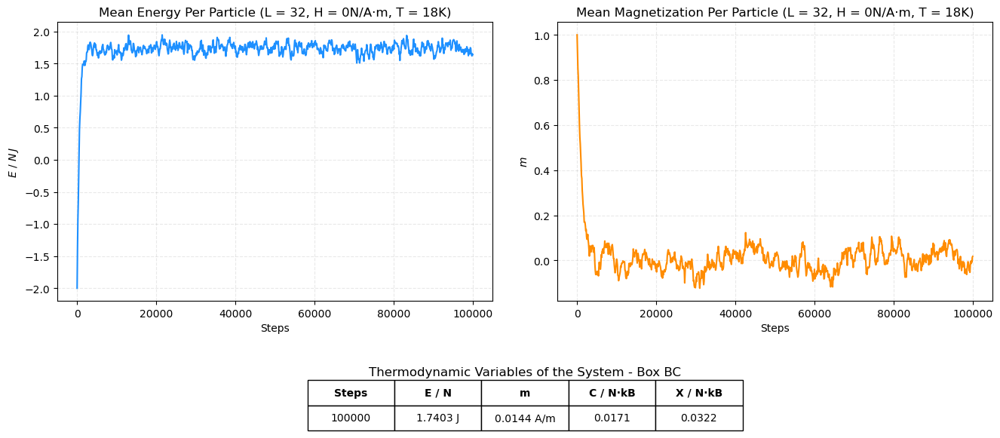

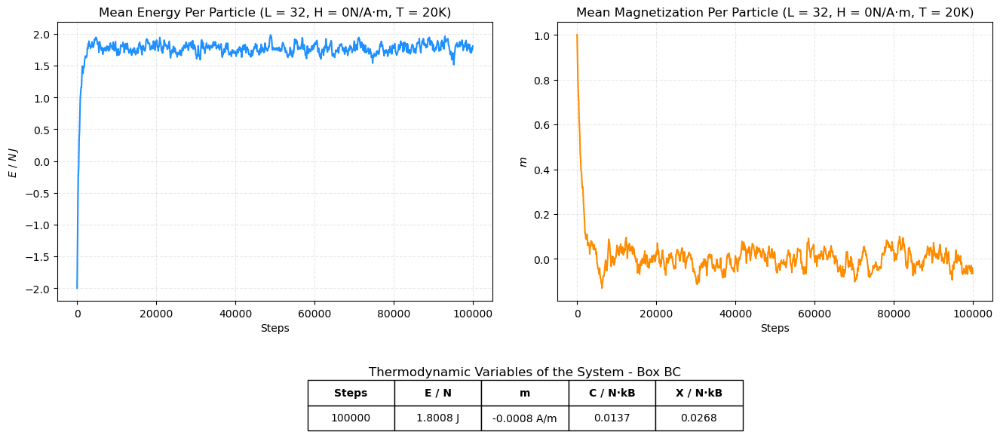

In [47]:
'''Set the system parameters'''
L = 32      #size of the lattice
H = 0       #external magnetic field [N / A * m]
n = 100000  #number of steps for the Metropolis algorithm

'''Set the range of temperatures to evaluate [K]'''
temps1 = [1, 2, 3, 4, 5, 6, 8, 10, 12, 14, 16, 18, 20]

'''Set lists to store the thermodynamic variables for each trial'''
e_tot, m_tot, C_tot, X_tot = [], [], [], []

'''Conduct ten trials at each temperature to find averages and errors'''
for trial in range(10):
    
    '''Store variables for each trial'''
    e_trial, m_trial, C_trial, X_trial = [], [], [], []
    
    '''Evaluate each temperature'''
    for T in temps1:
        
        '''Create an instance of the class and conduct the Metropolis algorithm'''
        d = Ising2D(L, H, T, 'Box')
        d.Metropolis(n)
        
        '''Append the variables for each temperature'''
        e_trial.append(d.e)
        m_trial.append(d.m)
        C_trial.append(d.C)
        X_trial.append(d.X)
        
        '''Plot the thermodynamic variables for the first trial'''
        if trial == 0:
            d.plot_em()
        
    '''Append the lists for each trial'''
    e_tot.append(e_trial)
    m_tot.append(m_trial)
    C_tot.append(C_trial)
    X_tot.append(X_trial)
    
'''Find the average and standard error for each temperature'''
e_avg, e_err = np.average(e_tot, axis = 0), np.std(e_tot, axis = 0) / np.sqrt(10)
m_avg, m_err = np.average(m_tot, axis = 0), np.std(m_tot, axis = 0) / np.sqrt(10)
C_avg, C_err = np.average(C_tot, axis = 0), np.std(C_tot, axis = 0) / np.sqrt(10)
X_avg, X_err = np.average(X_tot, axis = 0), np.std(X_tot, axis = 0) / np.sqrt(10)

##### We do not know the exact solutions for the average energy per particle, average magnetization per particle, heat capacity per particle, and susceptibility per particle.  Therefore, we will simply plot the results of these thermodynamic variables near the critical temperature and will discuss the trends due to the temperature.

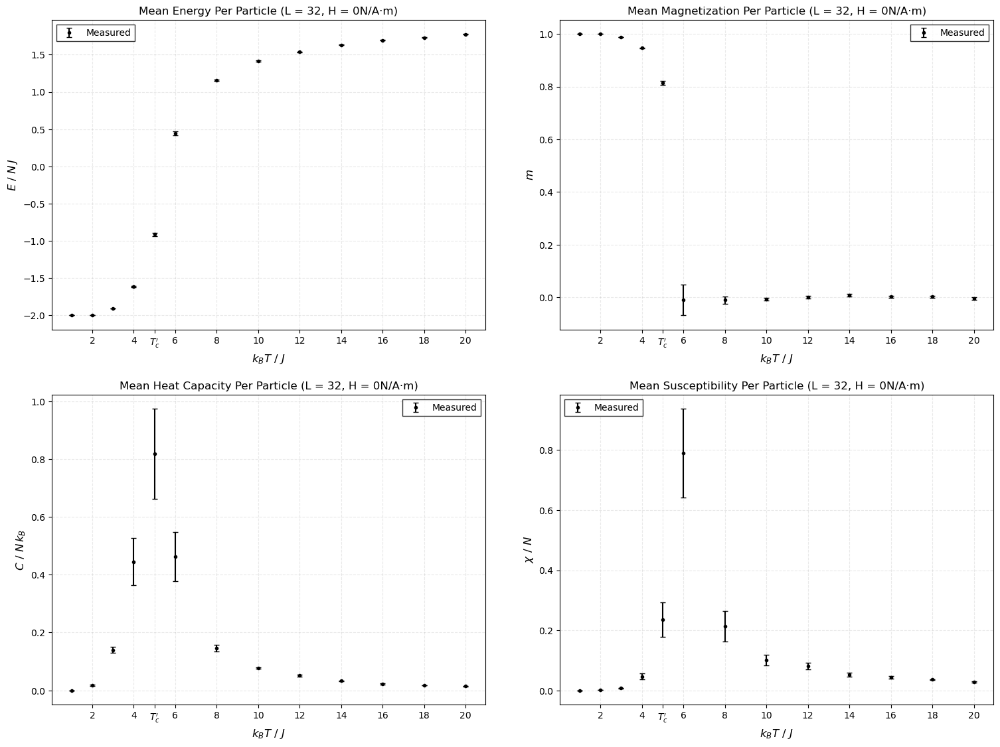

In [50]:
'''Create figure'''
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize = (16, 12), gridspec_kw = {'width_ratios': [1, 1],
                                                                                     'height_ratios': [1, 1]})
fig.tight_layout(pad = 5)
for ax in [ax1, ax2, ax3, ax4]:
    ax.set_xlabel('$k_BT\ /\ J$', fontsize = 12)
    ax.set_xticks([0, 2, 4, 5, 6, 8, 10, 12, 14, 16, 18, 20, 22])
    ax.set_xticklabels(['0', '2', '4', '$T_c^{\prime}$', '6', '8', '10', '12', '14', '16', '18', '20', '22'])
    ax.grid(True, linestyle = 'dashed', color = 'darkgray', alpha = 0.25)
    
'''First figure --> E / NJ'''
ax1.set_ylabel('$E\ /\ N\,J$', fontsize = 12)
ax1.set_title(f'Mean Energy Per Particle (L = {L}, H = {H}N/A\u00B7m)')
ax1.errorbar(temps1, e_avg, yerr = e_err, capsize = 3, fmt = 'k.', zorder = 5, label = 'Measured')
legend1 = ax1.legend(loc='upper left', fancybox = False)
frame1 = legend1.get_frame()
frame1.set_facecolor('white')
frame1.set_edgecolor('black')
frame1.set_linewidth(1)

'''Second figure --> m'''
ax2.set_ylabel('$m$', fontsize = 12)
ax2.set_title(f'Mean Magnetization Per Particle (L = {L}, H = {H}N/A\u00B7m)')
ax2.errorbar(temps1, m_avg, yerr = m_err, capsize = 3, fmt = 'k.', zorder = 5, label = 'Measured')
legend2 = ax2.legend(loc='upper right', fancybox = False)
frame2 = legend2.get_frame()
frame2.set_facecolor('white')
frame2.set_edgecolor('black')
frame2.set_linewidth(1)

'''Third figure --> C / N kB'''
ax3.set_ylabel('$C\ /\ N\,k_B$', fontsize = 12)
ax3.set_title(f'Mean Heat Capacity Per Particle (L = {L}, H = {H}N/A\u00B7m)')
ax3.errorbar(temps1, C_avg, yerr = C_err, capsize = 3, fmt = 'k.', zorder = 5, label = 'Measured')
legend3 = ax3.legend(loc='upper right', fancybox = False)
frame3 = legend3.get_frame()
frame3.set_facecolor('white')
frame3.set_edgecolor('black')
frame3.set_linewidth(1)

'''Fourth figure --> E / N'''
ax4.set_ylabel('$\chi\ /\ N$', fontsize = 12)
ax4.set_title(f'Mean Susceptibility Per Particle (L = {L}, H = {H}N/A\u00B7m)')
ax4.errorbar(temps1, X_avg, yerr = X_err, capsize = 3, fmt = 'k.', zorder = 5, label = 'Measured')
legend4 = ax4.legend(loc='upper left', fancybox = False)
frame4 = legend4.get_frame()
frame4.set_facecolor('white')
frame4.set_edgecolor('black')
frame4.set_linewidth(1)

'''Save figure'''
fig.savefig('c:/Users/Tucker Knaak/Downloads/1024Spins_H0_VaryingT_emcX_Box.png', bbox_inches = 'tight')

##### In this simulation, we used temperatures ranging from $T=1\text{K}$ to $T=20\text{K}$ in $2\text{K}$ intervals.  We found the same qualitative dependence on temperature for these thermodynamic temperatures with the Box BC compared to that of the Toroidal BC.  However, we found that the "critical temperature" has shifted for the Box BC.  Due to the extra interactions of the spins, we found that the new "critical temperature", where the system transitions from the ferromagnetic phase to the paramagnetic phase, occurs approximately at $T_c^{\prime}\approx5\text{K}$.  The trends for the Box BC then followed similarly from those of the Toroidal BC.  

##### (1) The average energy per particle increased as the temperature increased and experienced a large jump at the new critical temperature.

##### (2) The average magnetization per particle was approximately $1$ at low temperatures since there is a definite preferred direction.  As the temperature became higher than the new critical temperature, the aveage magnetization per particle became approximately $0$ since the spins became randomly oriented.

##### (3) The heat capacity per particle was approximately $0$ at both low and high temperatures.  This followed from the fact that increasing the temperature of the system will not cause large changes in energy due to the orientation of the spins in these limits.  However, at the new critical temperature, the heat capacity spikes as the system undergoes a phase transition from ferromagnetic to paramagnetic.

##### (4) The susceptibility per particle was approximately $0$ at both low and high temperatures.  This followed from the fact that increasing the temperature will not cause a large change in the magnetization due to the orientation of the spins in these limits.  However, at the new critical temperature, the susceptibility spikes as the system undergoes a phase transition from ferromagnetic to paramagnetic.